# Imports

In [1]:
import airr
import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
import numpy as np
import pandas as pd
import sys
sys.path.append('/mnt/md0/s236922/cowell-lab/repertoire_zoo/')
import repertoire_zoo.bird as br
import repertoire_zoo.giraffe as gr

/home/s236922/apps/miniconda3/envs/zoo/lib/python3.13/site-packages/airr/schema.py:10: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to Setuptools<81.
  from pkg_resources import resource_stream


# Setup Data Directories

In [2]:
# '/mnt/md0/Projects/MonsonLab/COVVAX/vdjserver/a9803592-eaa3-47b5-ac99-d91e8a1434fc-007' <- initial groups defined
# '/mnt/md0/Projects/MonsonLab/COVVAX/vdjserver/1a011c26-48a1-4a2d-8dce-47faa65e1b8b-007' <- more groups

project_id='c0aef9ef-362d-46fd-abba-39ac0945bd66'
job_id='1a011c26-48a1-4a2d-8dce-47faa65e1b8b-007'

data_dir = '/mnt/md0/Projects/MonsonLab/COVVAX/'
repcalc_dir = data_dir + 'vdjserver/'+job_id+'/'
analysis_dir = data_dir + 'analysis/'
fig_dir = analysis_dir + 'figures/'

# Read in Data

In [3]:
sample_info_df = br.read_repertoire_info_airr(repcalc_dir + 'repertoires.airr.json')
repertoire_group_df = br.read_repertoire_group_info_airr(repcalc_dir + 'repertoires.airr.json')

data = airr.read_airr(repcalc_dir + 'repertoires.airr.json')
repertoire_groups = { obj['repertoire_group_id'] : obj for obj in data['RepertoireGroup'] }

groups = [
    (repertoire_group_df.loc[i,'repertoire_group_id'], repertoire_group_df.loc[i,'name']) 
    for i in range(len(repertoire_group_df))
]

for rep_group_id in repertoire_groups:
    print(rep_group_id, repertoire_groups[rep_group_id]['repertoire_group_name'])



Total Number of Repertoire Groups:  22
b08f9f20-8770-42e2-a785-ff9443b6edb6 High Neutralization
167ecf28-c395-40ed-9651-a7ef7d0784cb Low Neutralization
ad5489b5-6cff-4773-bb76-ec09b2573ff3 Cat. 1 High Neutralization
08475c9e-efb6-4302-8bb1-77186b5b86b9 Cat. 1 Low Neutralization
1672807c-ba98-4ec4-aa96-e2023c4dd23a Cat. 4-5 High Neutralization
2abdc4e5-dd79-4c39-b7b9-b4e8ee642ec1 Cat. 6 Low Neutralization
fece9f9e-b20e-4df2-bd24-fc4e8cc213d3 Cat. 6 High Neutralization
3621f37f-2b34-478b-af42-ef1fb1f7e799 Cat. 7 High Neutralization
540bc5f1-2a71-4dbc-833f-e01e562e7e03 Cat. 2-7 Low Neutralization
a57c907d-39aa-407c-99df-9c105d43407d Cat. 2-7 High Neutralization
523b4d12-eb73-4a29-bbdd-ebe17576554f Healthy Control
8a1cd1bd-9279-4cb7-883a-1b8ad7f0764f Heme Cancer
d262632b-51d7-49f9-9505-d7ac839f6938 Neuroimmunology
ffb943d1-7afa-484d-88f2-3dd2efc0b102 Solid Cancer
67e77903-4ee3-4e54-9690-acf4a316a7a4 Healthy Control Low Neutralization
3357bc71-0423-495e-9745-b159398e84ec Healthy Control Hig

# Helper Functions

In [5]:
def set_sharedy(axes:list):
    y_lims = [ax.get_ylim() for ax in axes]
    for y_lim in y_lims:
        print(y_lim)

    y_lim_min = min([y_lim[0] for y_lim in y_lims])
    y_lim_max = max([y_lim[1] for y_lim in y_lims])

    for ax in axes:
        ax.set_ylim((y_lim_min, y_lim_max))

def plot_two_side_by_side(plot1, plot2, figsize=(12, 6), sharey=False, suptitle=None, projection1='rectilinear', projection2='rectilinear'):
    """
    Plots two matplotlib subplots side by side using the given plotting functions.

    Parameters
    ----------
    plot1 : function
        A function that takes a single argument `ax` and plots on it.
    plot2 : function
        A second plotting function like `plot1`.
    figsize : tuple, optional
        Size of the figure, default is (12, 6).
    sharey : bool, optional
        Whether the y-axis should be shared between the plots.
    suptitle : str, optional
        Optional super title for the figure.
    projection1 : str, optional
        The type of projection for the left subplot. Commonly used is `rectilinear` and `polar`. (Deafult: `rectilinear`.)
    projection2 : str, optional
        The type of projection for the right subplot. Commonly used is `rectilinear` and `polar`. (Deafult: `rectilinear`.)
    """
    fig = plt.figure(figsize=figsize)
    gs = GridSpec(2, 2, height_ratios=[1, 1], figure=fig)

    # Create two PolarAxes manually
    ax1 = fig.add_subplot(gs[0, 0], projection=projection1)
    ax2 = fig.add_subplot(gs[0, 1], projection=projection2)
    axes = [ax1, ax2]
    
    if sharey:
        set_sharedy(axes)
        
    plot1(ax1)
    plot2(ax2)
    
    if suptitle:
        fig.suptitle(suptitle, fontsize=16)
    
    plt.tight_layout()
    plt.show()
    return fig, (ax1, ax2)

def plot_three_split_layout(plot_top, plot_bottom_left, plot_bottom_right, figsize=(12, 8), sharey=False, suptitle=None, projection_top:str='rectilinear', projection_bottom_left:str='rectilinear', projection_bottom_right:str='rectilinear'):
    """
    Create a figure with 3 subplots:
    - Top: one plot spanning the top half of the figure.
    - Bottom: two plots side by side.

    Parameters
    ----------
    plot_top : function
        Plotting function that accepts a single `ax` argument for the top plot.
    plot_bottom_left : function
        Plotting function for the bottom-left subplot.
    plot_bottom_right : function
        Plotting function for the bottom-right subplot.
    figsize : tuple, optional
        Size of the figure, default is (12, 8).
    sharey : bool, optional
        Whether the y-axis should be shared between the plots.
    suptitle : str, optional
        Optional super title for the figure.
    projection_top : str, optional
        The type of projection for the top subplot. Commonly used is `rectilinear` and `polar`. (Deafult: `rectilinear`.)
    projection_bottom_left : str, optional
        The type of projection for the bottom left subplot. Commonly used is `rectilinear` and `polar`. (Deafult: `rectilinear`.)
    projection_bottom_right : str, optional
        The type of projection for the bottom right subplot. Commonly used is `rectilinear` and `polar`. (Deafult: `rectilinear`.)
    """
    fig = plt.figure(figsize=figsize)
    gs = GridSpec(2, 2, height_ratios=[1, 1], figure=fig)

    ax_top = fig.add_subplot(gs[0, :], projection=projection_top)       # spans both columns
    ax_bottom_left = fig.add_subplot(gs[1, 0], projection=projection_bottom_left)
    ax_bottom_right = fig.add_subplot(gs[1, 1], projection=projection_bottom_right)
    axes = [ax_top, ax_bottom_left, ax_bottom_right]

    if sharey:
        set_sharedy(axes)

    plot_top(ax_top)
    plot_bottom_left(ax_bottom_left)
    plot_bottom_right(ax_bottom_right)

    if suptitle:
        fig.suptitle(suptitle, fontsize=16)

    plt.tight_layout(rect=[0, 0, 1, 0.96])  # leave space for suptitle
    plt.show()
    return fig, (ax_top, ax_bottom_left, ax_bottom_right)

def plot_two_by_two_layout(plot_top_left, plot_top_right, plot_bottom_left, plot_bottom_right, figsize=(12, 12), sharey=False, suptitle=None, projection_top_left:str='rectilinear', projection_top_right:str='rectilinear', projection_bottom_left:str='rectilinear', projection_bottom_right:str='rectilinear'):
    """
    Create a figure with 3 subplots:
    - Top: one plot spanning the top half of the figure.
    - Bottom: two plots side by side.

    Parameters
    ----------
    plot_top : function
        Plotting function that accepts a single `ax` argument for the top plot.
    plot_bottom_left : function
        Plotting function for the bottom-left subplot.
    plot_bottom_right : function
        Plotting function for the bottom-right subplot.
    figsize : tuple, optional
        Size of the figure, default is (12, 8).
    suptitle : str, optional
        Optional super title for the figure.
    projection_top_left : str, optional
        The type of projection for the top subplot. Commonly used is `rectilinear` and `polar`. (Deafult: `rectilinear`.)
    projection_top_right : str, optional
        The type of projection for the top subplot. Commonly used is `rectilinear` and `polar`. (Deafult: `rectilinear`.)
    projection_bottom_left : str, optional
        The type of projection for the bottom left subplot. Commonly used is `rectilinear` and `polar`. (Deafult: `rectilinear`.)
    projection_bottom_right : str, optional
        The type of projection for the bottom right subplot. Commonly used is `rectilinear` and `polar`. (Deafult: `rectilinear`.)
    """
    fig = plt.figure(figsize=figsize)
    gs = GridSpec(2, 2, height_ratios=[1, 1], figure=fig)

    ax_top_left = fig.add_subplot(gs[0, 0], projection=projection_top_left)
    ax_top_right = fig.add_subplot(gs[0, 1], projection=projection_top_right)
    ax_bottom_left = fig.add_subplot(gs[1, 0], projection=projection_bottom_left)
    ax_bottom_right = fig.add_subplot(gs[1, 1], projection=projection_bottom_right)
    axes = [ax_top_left, ax_top_right, ax_bottom_left, ax_bottom_right]

    plot_top_right(ax_top_right)
    plot_top_left(ax_top_left)
    plot_bottom_left(ax_bottom_left)
    plot_bottom_right(ax_bottom_right)
    
    if sharey:
        set_sharedy(axes)

    if suptitle:
        fig.suptitle(suptitle, fontsize=16)

    plt.tight_layout(rect=[0, 0, 1, 0.96])  # leave space for suptitle
    plt.show()
    return fig, (ax_top_left, ax_top_right, ax_bottom_left, ax_bottom_right)

# Setup Colormaps

In [6]:
cmap = mpl.colormaps['nipy_spectral'] # gist_rainbow
cmin = 0.0
cmax = 1.0

# V
v_genes = br.load_gene_usage_group_data(
    repcalc_dir=repcalc_dir,
    groups=groups,
    processing_stage='igblast.makedb.gene.clone',
    call_type='v_call',
    level='gene'
)['gene'].unique()
v_genes_cmap = {
    v_gene : cmap(np.linspace(cmin,cmax,len(v_genes))[i])
    for i, v_gene in enumerate(v_genes)
}

v_subgroups = br.load_gene_usage_group_data(
    repcalc_dir=repcalc_dir,
    groups=groups,
    processing_stage='igblast.makedb.gene.clone',
    call_type='v_call',
    level='subgroup'
)['gene'].unique()
v_subgroup_cmap = {
    v_subgroup : cmap(np.linspace(cmin,cmax,len(v_subgroups))[i])
    for i, v_subgroup in enumerate(v_subgroups)
}

# J
j_genes = br.load_gene_usage_group_data(
    repcalc_dir=repcalc_dir,
    groups=groups,
    processing_stage='igblast.makedb.gene.clone',
    call_type='j_call',
    level='gene'
)['gene'].unique()
j_genes_cmap = {
    j_gene : cmap(np.linspace(cmin,cmax,len(j_genes))[i])
    for i, j_gene in enumerate(j_genes)
}

j_subgroups = br.load_gene_usage_group_data(
    repcalc_dir=repcalc_dir,
    groups=groups,
    processing_stage='igblast.makedb.gene.clone',
    call_type='j_call',
    level='subgroup'
)['gene'].unique()
j_subgroup_cmap = {
    j_subgroup : cmap(np.linspace(cmin,cmax,len(j_subgroups))[i])
    for i, j_subgroup in enumerate(j_subgroups)
}

# cond_cmap
conds = br.load_and_prepare_data_junction_aa(
    repcalc_dir=repcalc_dir,
    groups=groups,
    processing_stage='.igblast.makedb.allele.clone.group.',
    call_type='junction_aa_length'
)['condition'].unique()
cond_cmap = {
    cond : cmap(np.linspace(cmin,cmax,len(conds))[i])
    for i, cond in enumerate(conds)
}


                       repertoire_group_id     level        mode  productive  \
0     b08f9f20-8770-42e2-a785-ff9443b6edb6    allele      unique       False   
1     b08f9f20-8770-42e2-a785-ff9443b6edb6    allele      unique       False   
2     b08f9f20-8770-42e2-a785-ff9443b6edb6    allele      unique       False   
3     b08f9f20-8770-42e2-a785-ff9443b6edb6    allele      unique       False   
4     b08f9f20-8770-42e2-a785-ff9443b6edb6    allele      unique       False   
...                                    ...       ...         ...         ...   
2191  b08f9f20-8770-42e2-a785-ff9443b6edb6  subgroup  proportion        True   
2192  b08f9f20-8770-42e2-a785-ff9443b6edb6  subgroup  proportion        True   
2193  b08f9f20-8770-42e2-a785-ff9443b6edb6  subgroup  proportion        True   
2194  b08f9f20-8770-42e2-a785-ff9443b6edb6  subgroup  proportion        True   
2195  b08f9f20-8770-42e2-a785-ff9443b6edb6  subgroup  proportion        True   

             gene  sequence_count  dupl

# TEST

# Gene Usage

In [6]:
threshold = 0.05
ylim_mult = 0.8

df = br.load_gene_usage_group_data(
    repcalc_dir=repcalc_dir,
    groups=groups,
    processing_stage='igblast.makedb.gene.clone',
    call_type='v_call',
    level='subgroup'
)

# pd.set_option("display.max_rows", None)
pd.set_option("display.max_rows", 10)
df

,gene,duplicate_frequency,duplicate_frequency_avg,duplicate_frequency_std,condition
0,IGHV1,2.027453e-01,0.162504,0.119946,Cat. 1 High Neutralization
1,IGHV1,1.072803e-01,0.098256,0.034655,Cat. 1 Low Neutralization
2,IGHV1,1.212864e-01,0.127970,0.069410,Cat. 2-7 High Neutralization
3,IGHV1,1.917520e-01,0.149067,0.090822,Cat. 2-7 Low Neutralization
4,IGHV1,1.241196e-01,0.114738,0.063082,Cat. 4-5 High Neutralization
...,...,...,...,...,...
149,IGLV1,2.256390e-07,0.000002,0.000022,Cat. 2-7 High Neutralization
150,IGLV1,4.992913e-07,0.000004,0.000031,Cat. 6 High Neutralization
151,IGLV1,2.196735e-07,0.000002,0.000021,High Neutralization
152,IGLV1,3.485879e-07,0.000003,0.000026,Solid Cancer


(np.float64(0.04000000000000001), np.float64(0.4314906360251756))
(np.float64(0.04000000000000001), np.float64(0.6036799288165756))
(np.float64(0.04000000000000001), np.float64(0.6036799288165756))
(np.float64(0.04000000000000001), np.float64(0.4314906360251756))


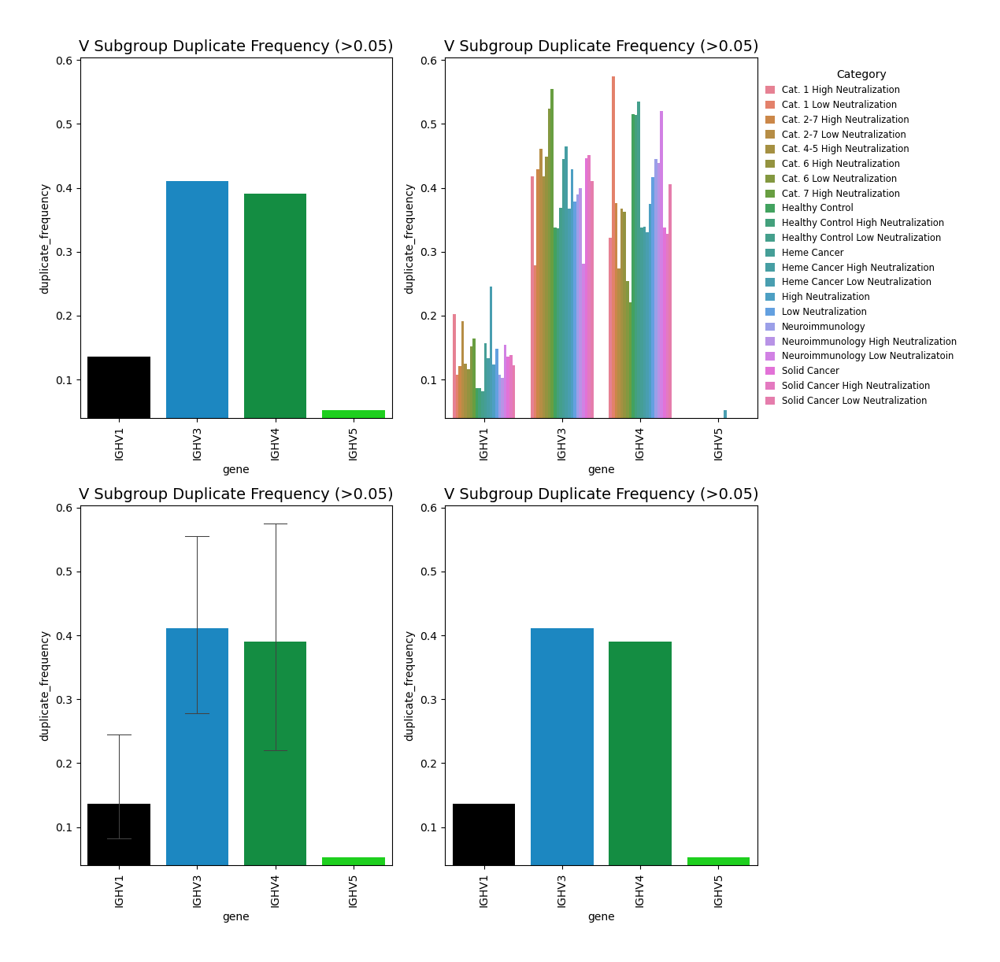

(<Figure size 1200x1200 with 4 Axes>,
 (<Axes: title={'center': 'V Subgroup Duplicate Frequency (>0.05)'}, xlabel='gene', ylabel='duplicate_frequency'>,
  <Axes: title={'center': 'V Subgroup Duplicate Frequency (>0.05)'}, xlabel='gene', ylabel='duplicate_frequency'>,
  <Axes: title={'center': 'V Subgroup Duplicate Frequency (>0.05)'}, xlabel='gene', ylabel='duplicate_frequency'>,
  <Axes: title={'center': 'V Subgroup Duplicate Frequency (>0.05)'}, xlabel='gene', ylabel='duplicate_frequency'>))

In [8]:
threshold = 0.05
ylim_mult = 0.8

df = br.load_gene_usage_group_data(
    repcalc_dir=repcalc_dir,
    groups=groups,
    processing_stage='igblast.makedb.gene.clone',
    call_type='v_call',
    level='subgroup'
)

# V Duplicate Frequency
def plot1(ax):
    gr.plot_duplicate_frequency(
        df=df,
        hue_order=None,
        palette=v_subgroup_cmap,
        threshold=threshold,
        title='V Subgroup Duplicate Frequency (>0.05)',
        ylim=(threshold*ylim_mult, None),
        ax=ax
    )

# split by Cat
def plot2(ax):
    gr.plot_duplicate_frequency(
        df=df,
        hue_order=None,
        palette=v_subgroup_cmap,
        threshold=threshold,
        title='V Subgroup Duplicate Frequency (>0.05)',
        ylim=(threshold*ylim_mult, None),
        split=True,
        ax=ax
    )

# std dev
def plot3(ax):
    gr.plot_duplicate_frequency(
        df=df,
        hue_order=None,
        palette=v_subgroup_cmap,
        threshold=threshold,
        title='V Subgroup Duplicate Frequency (>0.05)',
        ylim=(threshold*ylim_mult, None),
        errorbar=True,
        ax=ax
    )

# data points
def plot4(ax):
    gr.plot_duplicate_frequency(
        df=df,
        hue_order=None,
        palette=v_subgroup_cmap,
        threshold=threshold,
        title='V Subgroup Duplicate Frequency (>0.05)',
        ylim=(threshold*ylim_mult, None),
        datapoints=True,
        ax=ax
    )

# plot_two_side_by_side(plot1, plot2)
plot_two_by_two_layout(plot1, plot2, plot3, plot4, sharey=True)

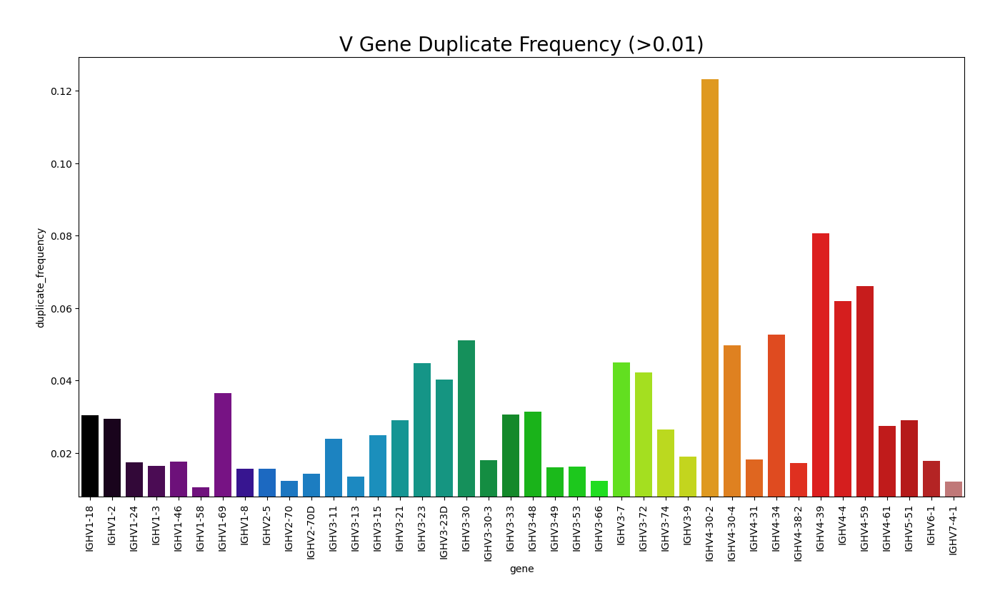

In [7]:
threshold = 0.01
ylim_mult = 0.8

df = br.load_gene_usage_group_data(
    repcalc_dir=repcalc_dir,
    groups=groups,
    processing_stage='igblast.makedb.gene.clone',
    call_type='v_call',
    level='gene'
)

fig, ax = gr.plot_duplicate_frequency(
    df=df,
    hue_order=None,
    palette=v_genes_cmap,
    threshold=threshold,
    title=f'V Gene Duplicate Frequency (>{threshold})',
    ylim=(ylim_mult*threshold, None)
)

fig.show()

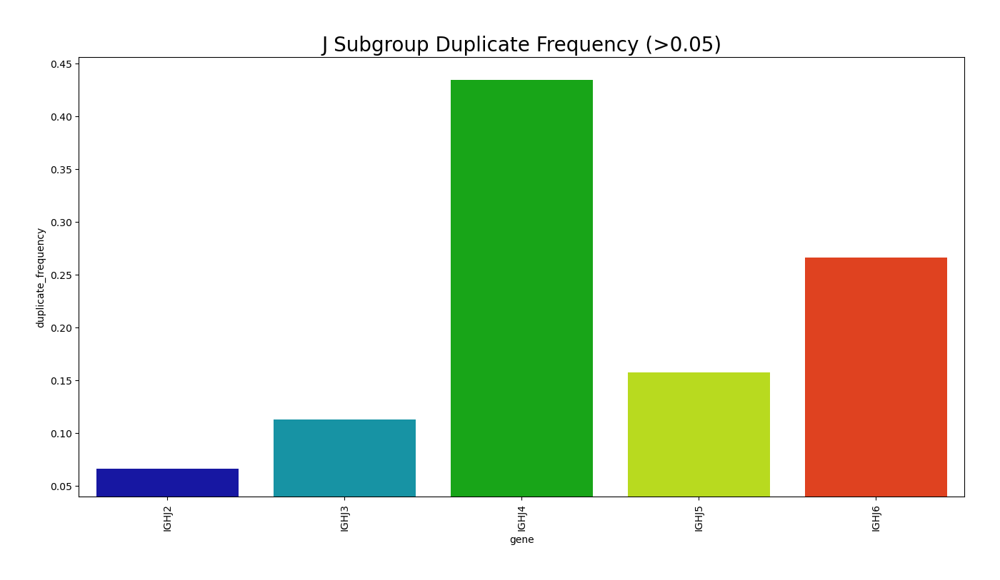

In [8]:
threshold = 0.05
ylim_mult = 0.8

df = br.load_gene_usage_group_data(
    repcalc_dir=repcalc_dir,
    groups=groups,
    processing_stage='igblast.makedb.gene.clone',
    call_type='j_call',
    level='subgroup'
)

fig, ax = gr.plot_duplicate_frequency(
    df=df,
    hue_order=None,
    palette=j_subgroup_cmap,
    threshold=threshold,
    title=f'J Subgroup Duplicate Frequency (>{threshold})',
    ylim=(threshold*ylim_mult, None)
)

fig.show()

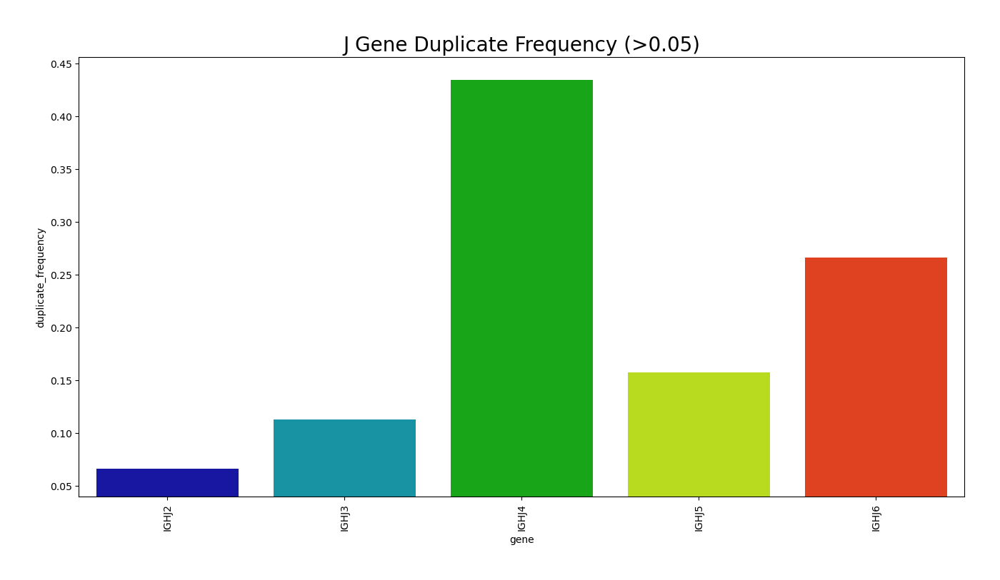

In [9]:
threshold = 0.05
ylim_mult = 0.8

df = br.load_gene_usage_group_data(
    repcalc_dir=repcalc_dir,
    groups=groups,
    processing_stage='igblast.makedb.gene.clone',
    call_type='j_call',
    level='gene'
)

fig, ax = gr.plot_duplicate_frequency(
    df=df,
    hue_order=None,
    palette=j_genes_cmap,
    threshold=0.05,
    title=f'J Gene Duplicate Frequency (>{threshold})',
    ylim=(threshold*ylim_mult, None)
)

fig.show()

# Junction AA Length

In [10]:
groups

[('b08f9f20-8770-42e2-a785-ff9443b6edb6', 'High Neutralization'),
 ('167ecf28-c395-40ed-9651-a7ef7d0784cb', 'Low Neutralization'),
 ('ad5489b5-6cff-4773-bb76-ec09b2573ff3', 'Cat. 1 High Neutralization'),
 ('08475c9e-efb6-4302-8bb1-77186b5b86b9', 'Cat. 1 Low Neutralization'),
 ('1672807c-ba98-4ec4-aa96-e2023c4dd23a', 'Cat. 4-5 High Neutralization'),
 ('2abdc4e5-dd79-4c39-b7b9-b4e8ee642ec1', 'Cat. 6 Low Neutralization'),
 ('fece9f9e-b20e-4df2-bd24-fc4e8cc213d3', 'Cat. 6 High Neutralization'),
 ('3621f37f-2b34-478b-af42-ef1fb1f7e799', 'Cat. 7 High Neutralization'),
 ('540bc5f1-2a71-4dbc-833f-e01e562e7e03', 'Cat. 2-7 Low Neutralization'),
 ('a57c907d-39aa-407c-99df-9c105d43407d', 'Cat. 2-7 High Neutralization'),
 ('523b4d12-eb73-4a29-bbdd-ebe17576554f', 'Healthy Control'),
 ('8a1cd1bd-9279-4cb7-883a-1b8ad7f0764f', 'Heme Cancer'),
 ('d262632b-51d7-49f9-9505-d7ac839f6938', 'Neuroimmunology'),
 ('ffb943d1-7afa-484d-88f2-3dd2efc0b102', 'Solid Cancer'),
 ('67e77903-4ee3-4e54-9690-acf4a316a7a4',

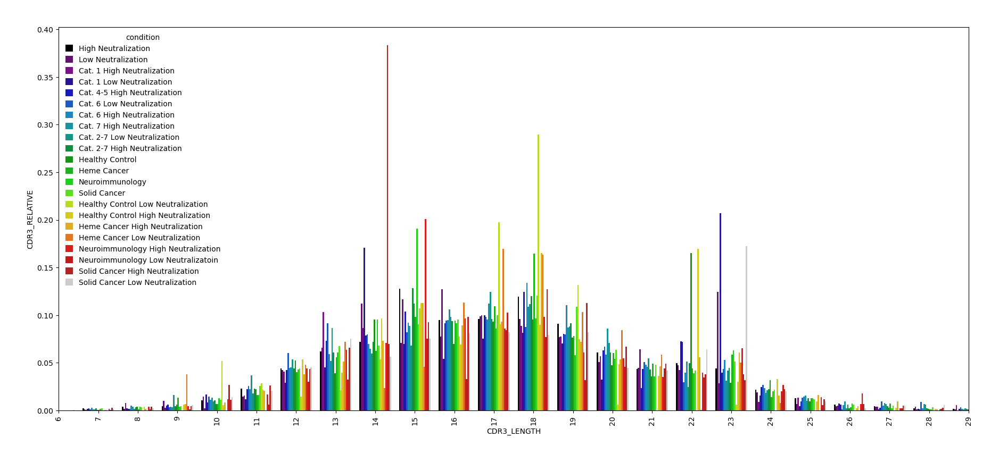

In [11]:
df = br.load_and_prepare_data_junction_aa(
    repcalc_dir=repcalc_dir,
    groups=groups,
    processing_stage='.igblast.makedb.allele.clone.group.',
    call_type='junction_aa_length'
)

fig, ax = gr.plot_junction_aa_length(
    df=df,
    x_col='CDR3_LENGTH',
    y_col='CDR3_RELATIVE',
    hue_col='condition',
    palette=cond_cmap
)

fig.show()

# VJ Combo Chord Diagram

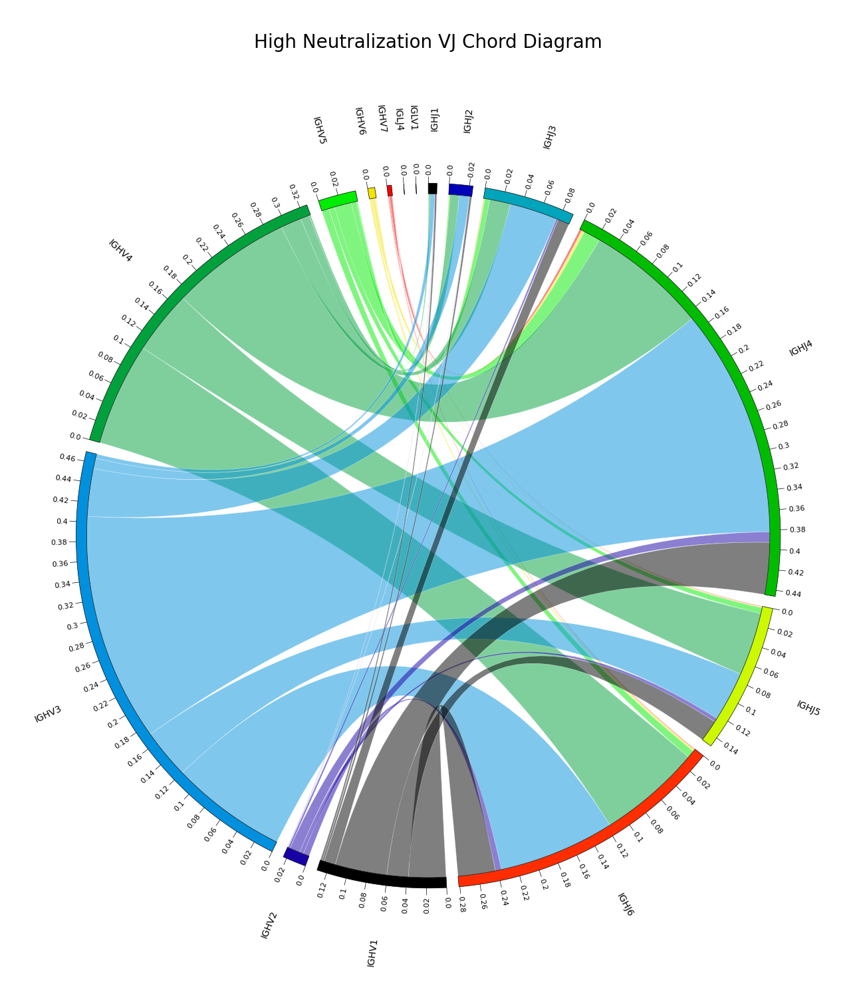

In [12]:
for group_id, group_name in groups:
    df = br.load_and_prepare_data_vj_combo(
        repcalc_dir=repcalc_dir,
        group_id=group_id,
        combo_type='vj_combo',
        processing_stage='.igblast.makedb.group.'
    )

    fig, ax = gr.plot_vj_chord_diagram(
        df=df,
        freq_col='duplicate_frequency_avg',
        ticks_interval=0.02,
        max_links=None,
        cmap=v_subgroup_cmap | j_subgroup_cmap,
        title=group_name+' VJ Chord Diagram'
    )
    
    break

    


# V Gene Duplicate Frequency

gene                        83
duplicate_frequency        145
duplicate_frequency_avg    154
duplicate_frequency_std    154
condition                    2
dtype: int64

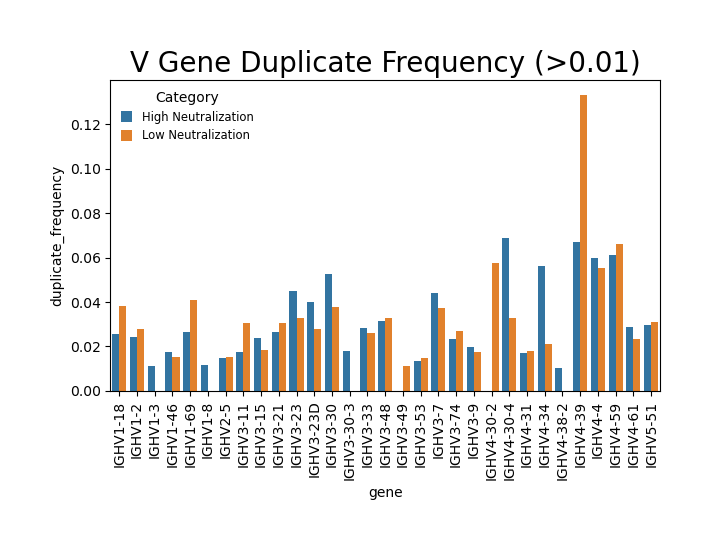

In [7]:
fig, ax = plt.subplots(1,1)

# V dup freq
threshold = 0.01
ylim_mult = 0

df = br.load_gene_usage_group_data(
    repcalc_dir=repcalc_dir,
    groups=groups[0:2],
    processing_stage='igblast.makedb.gene.clone',
    call_type='v_call',
    level='gene'
)

gr.plot_duplicate_frequency(
    df=df,
    palette=v_genes_cmap,
    threshold=threshold,
    title=f'V Gene Duplicate Frequency (>{threshold})',
    ylim=(ylim_mult*threshold, None),
    ax=ax,
    split=True
)

fig.show()
df.nunique()


# Mutational Data

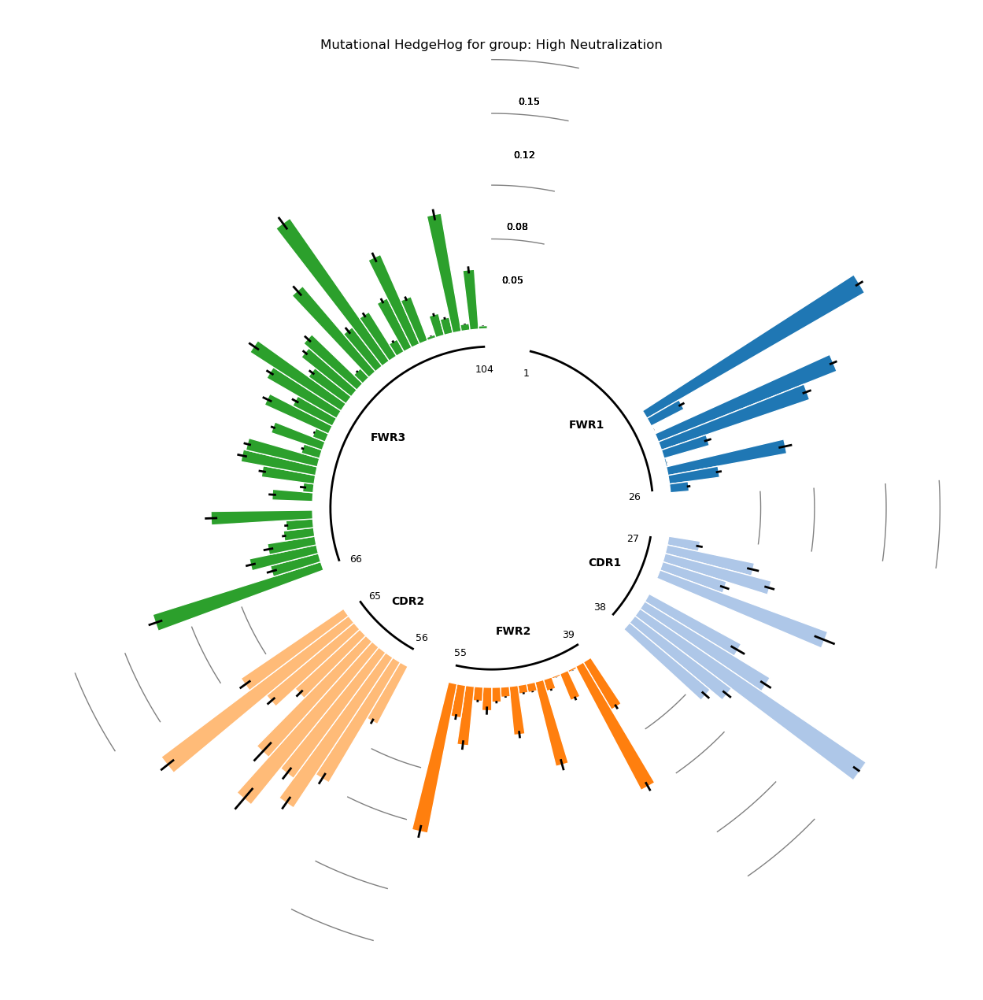

In [ ]:
for group_id, group_name in groups:
    df = br.load_and_prepare_mutation_data(
        mutation_data_dir=repcalc_dir,
        group_id=group_id,
        trim_codons=16,
        processing_stage='igblast.makedb.gene.clone.mutations'
    )
    # print(df)
    fig, ax = gr.plot_mutational_hedgehog(
        df=df,
        figsize=(12,12),
        title=f'Mutational HedgeHog for group: {group_name}',
    )

    fig.show()

In [16]:
df.head()

,place,group,value,se,se_start,se_end
0,1,FWR1,0.0,0.0,0.0,0.0
1,2,FWR1,0.0,0.0,0.0,0.0
2,3,FWR1,0.0,0.0,0.0,0.0
3,4,FWR1,0.0,0.0,0.0,0.0
4,5,FWR1,0.0,0.0,0.0,0.0


# Multi plots

## Duplicate Freqeuncy & VJ Chord Diagram

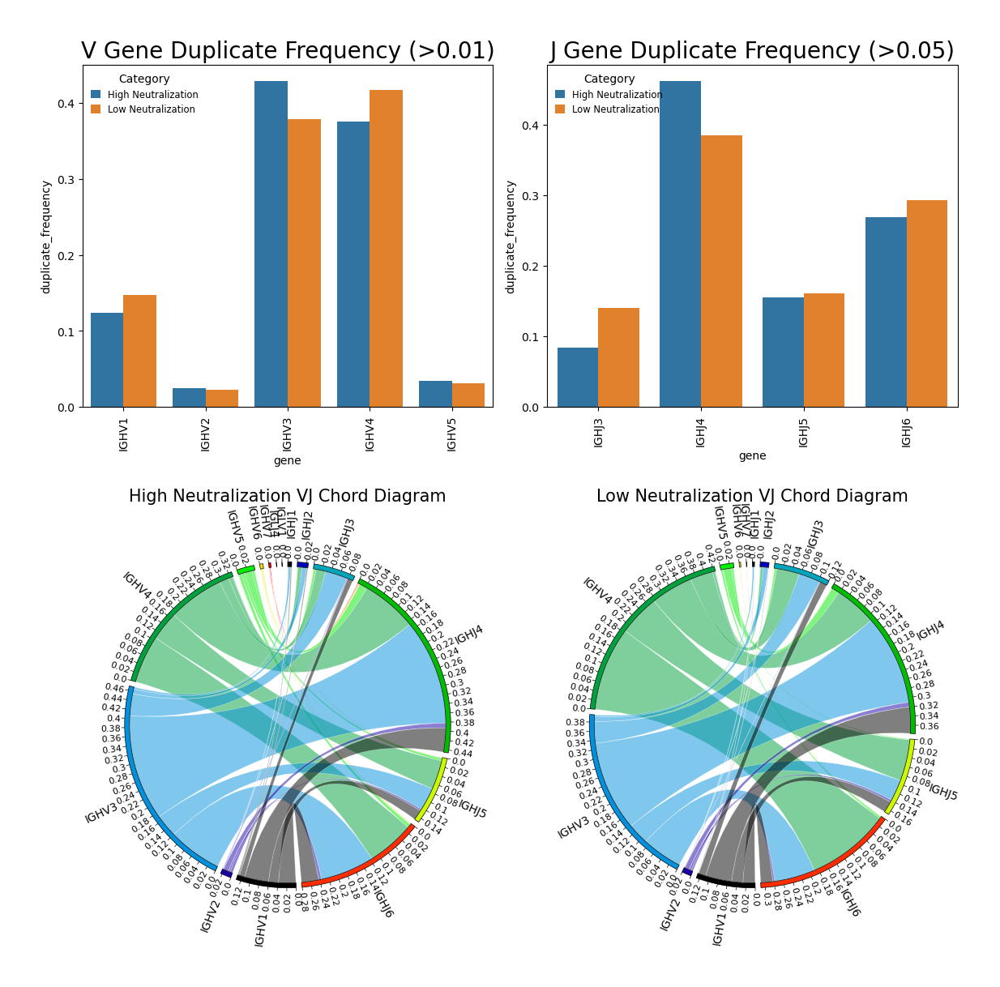

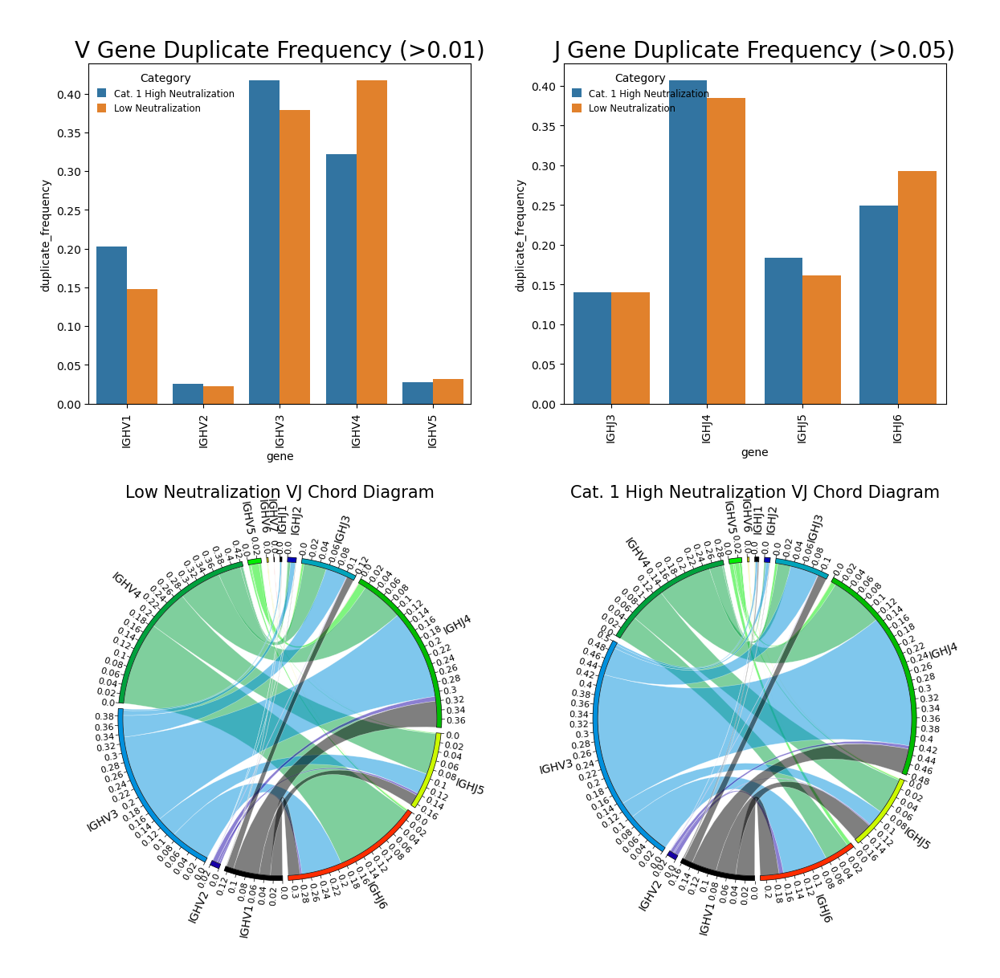

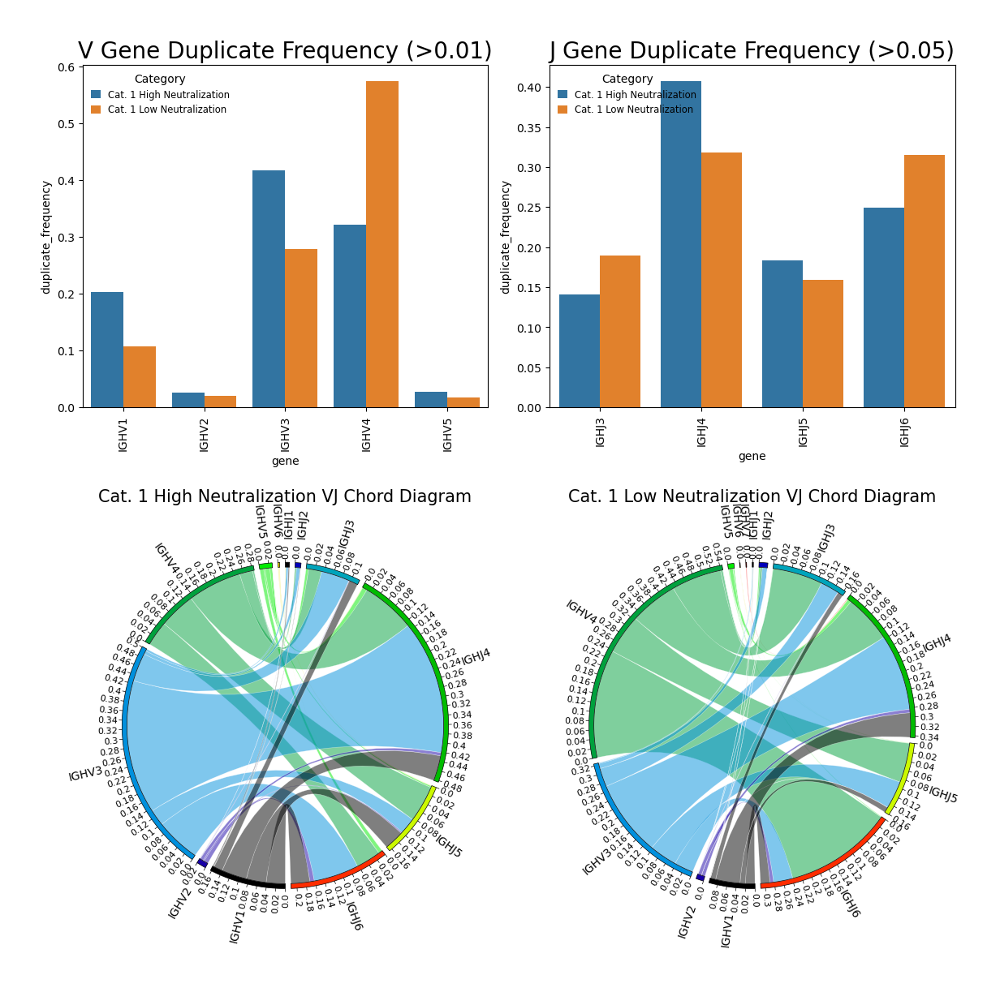

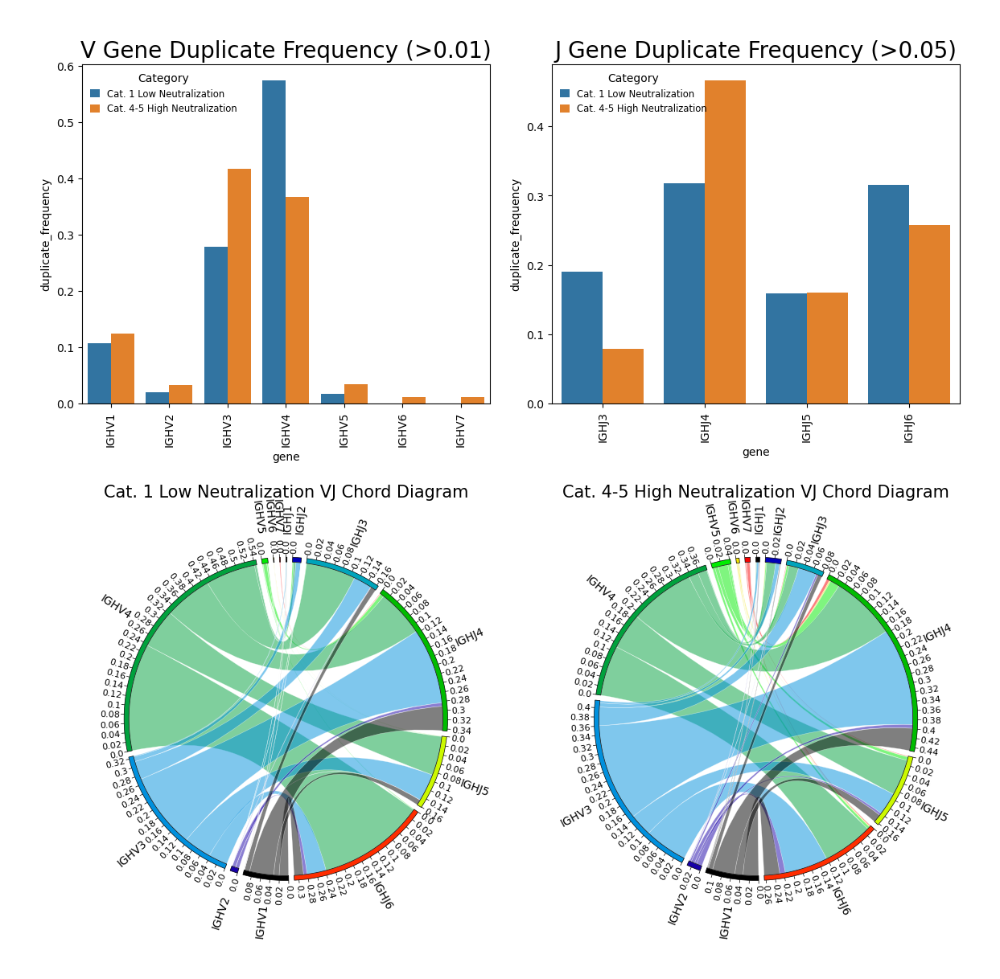

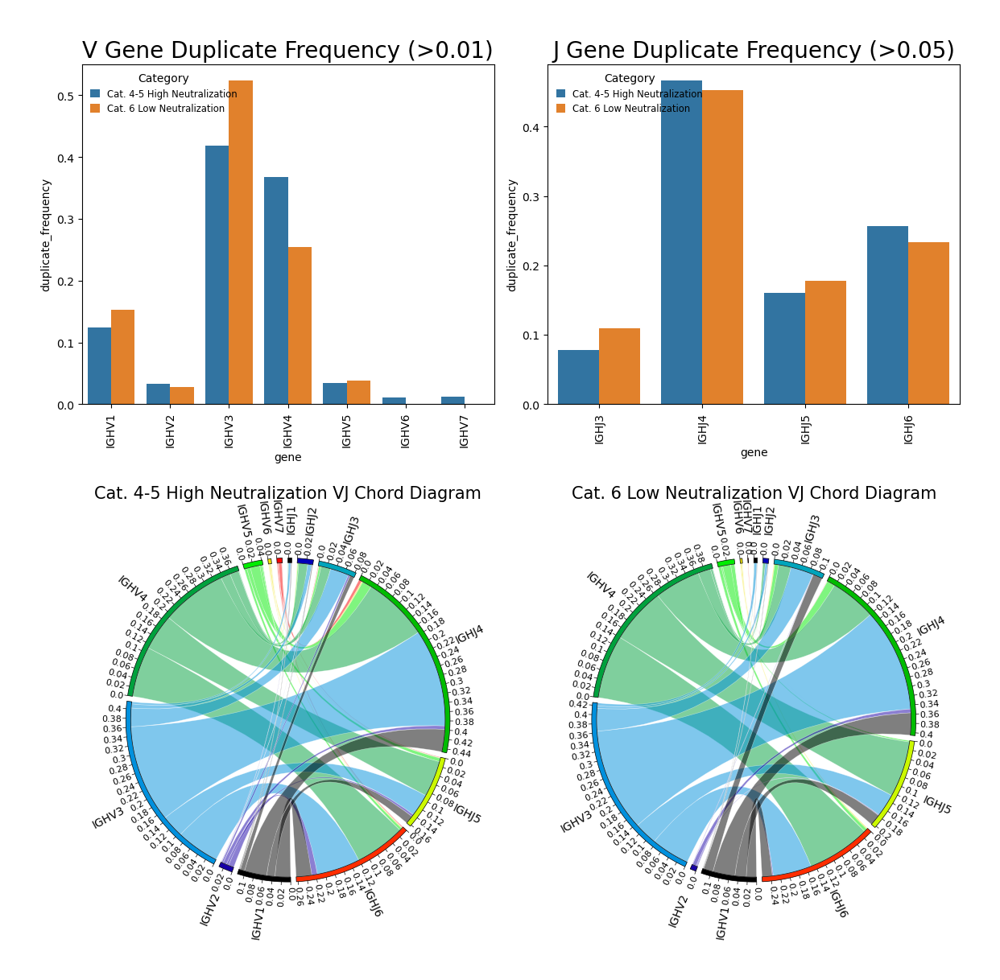

...

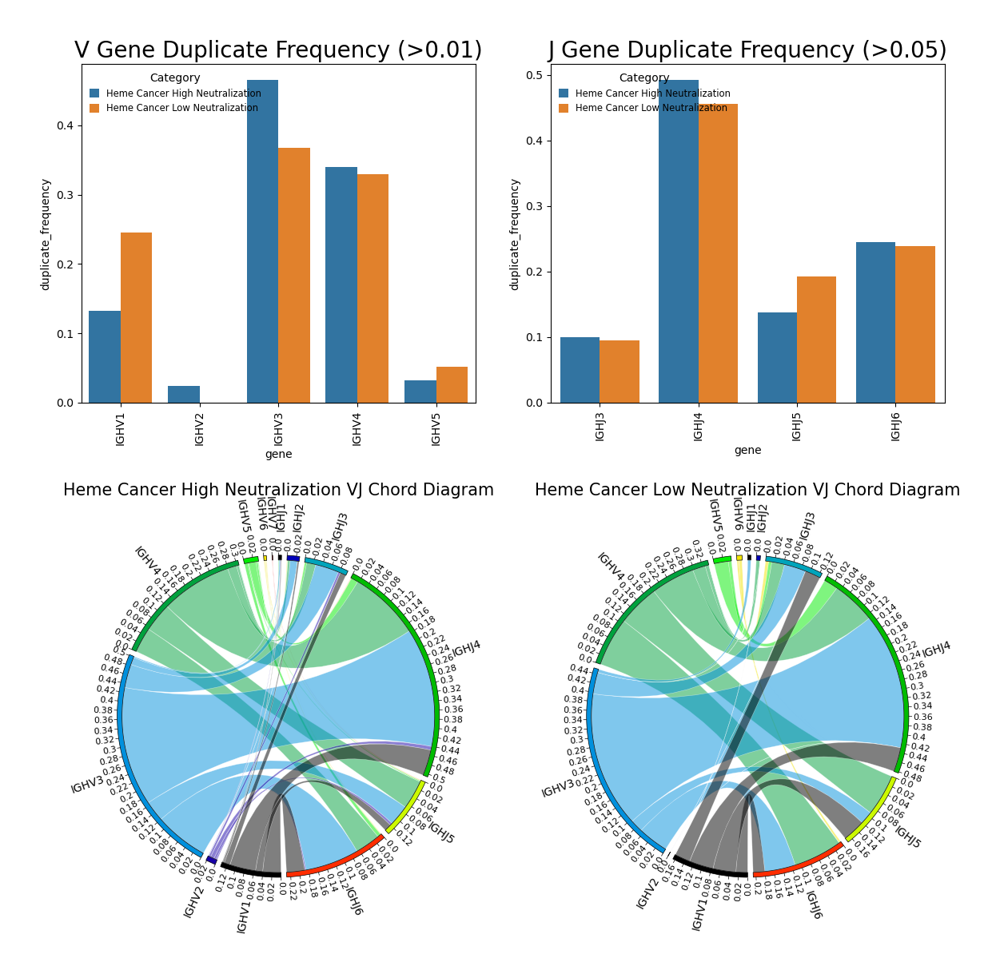

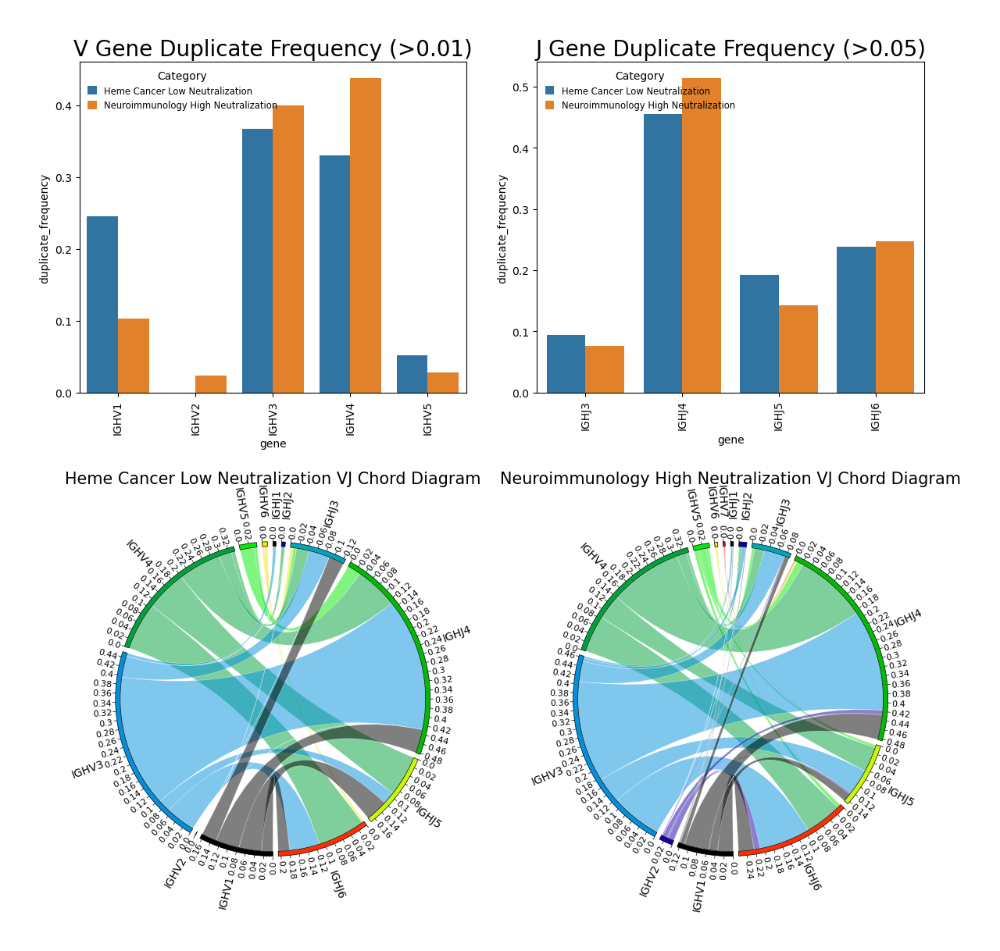

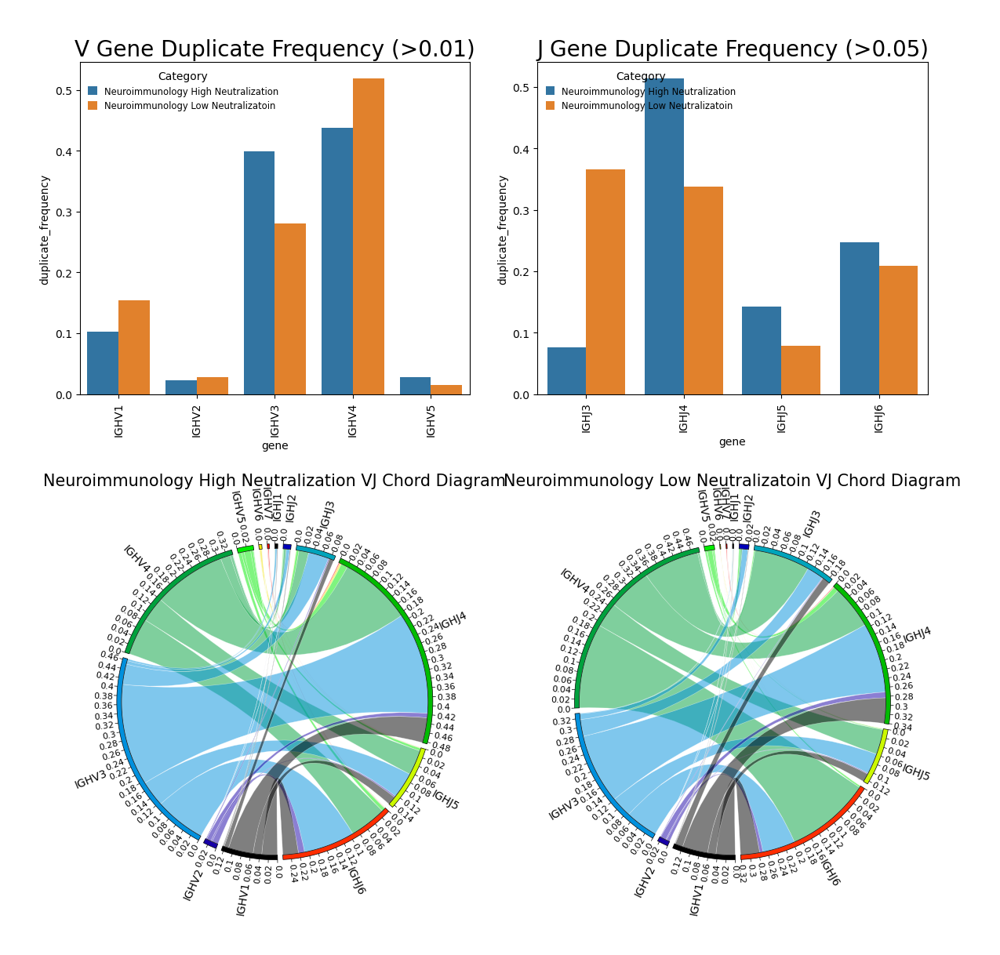

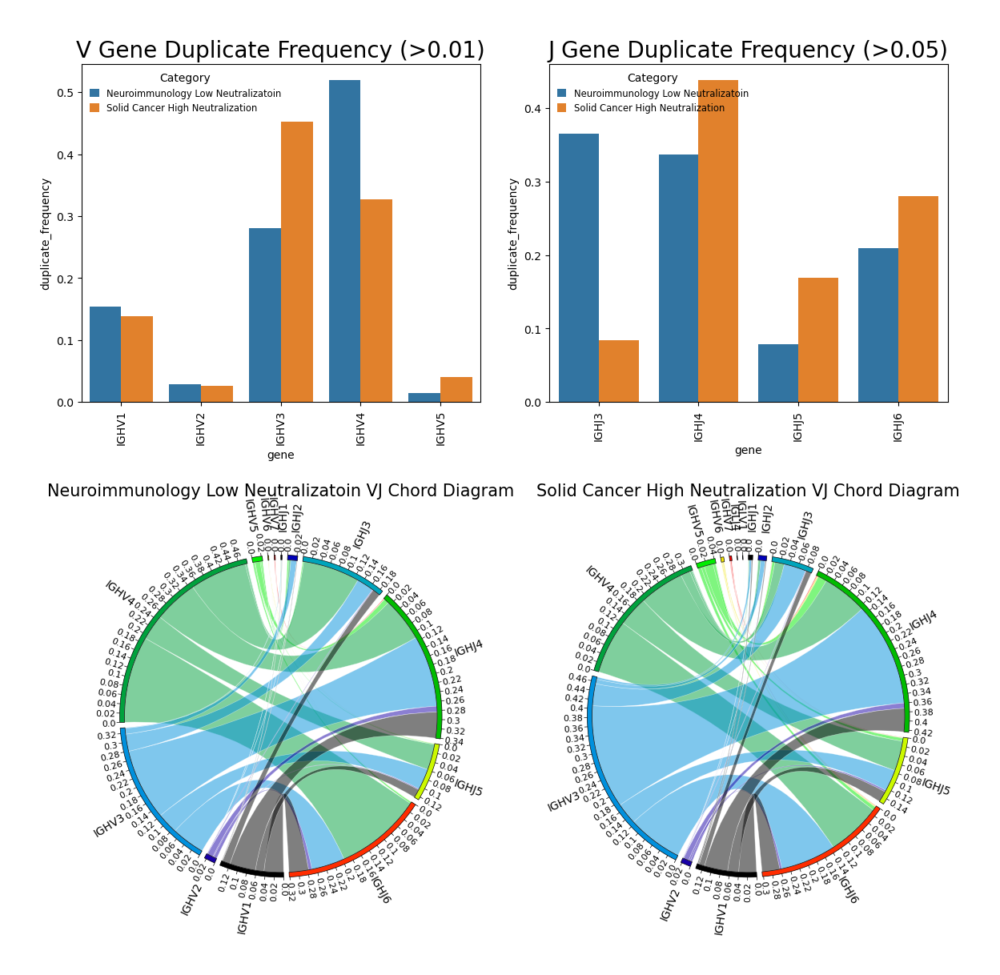

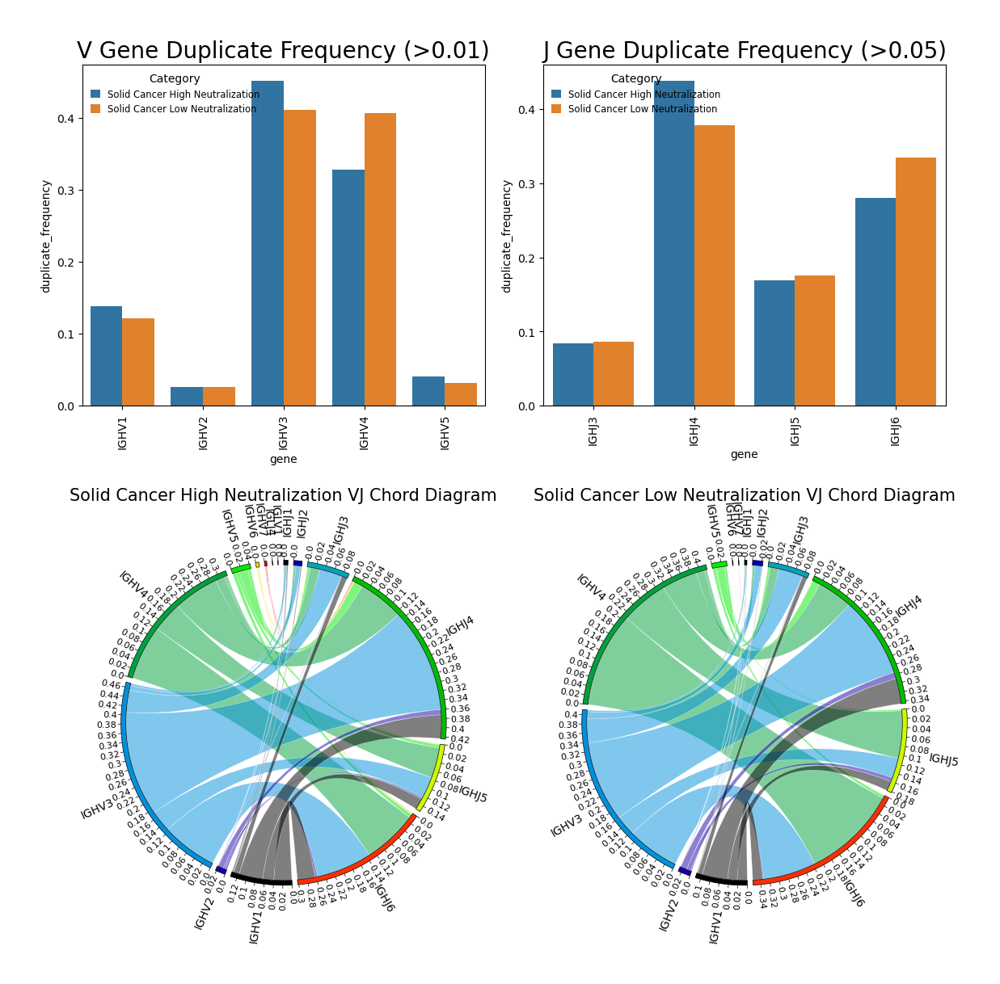

In [9]:
for i, (group_id, group_name) in enumerate(groups):

    if i!=0:
        small_group = [
            (prev_group_id, prev_group_name),
            (group_id, group_name)
        ]

        def plot_top_left(ax):
            # V dup freq
            threshold = 0.01
            ylim_mult = 0

            df = br.load_gene_usage_group_data(
                repcalc_dir=repcalc_dir,
                groups=small_group,
                processing_stage='igblast.makedb.gene.clone',
                call_type='v_call',
                level='subgroup'
            )

            gr.plot_duplicate_frequency(
                df=df,
                threshold=threshold,
                title=f'V Gene Duplicate Frequency (>{threshold})',
                ylim=(ylim_mult*threshold, None),
                ax=ax,
                split=True
            )

        def plot_top_right(ax):
            threshold = 0.05
            ylim_mult = 0

            df = br.load_gene_usage_group_data(
                repcalc_dir=repcalc_dir,
                groups=small_group,
                processing_stage='igblast.makedb.gene.clone',
                call_type='j_call',
                level='subgroup'
            )

            gr.plot_duplicate_frequency(
                df=df,
                threshold=0.05,
                title=f'J Gene Duplicate Frequency (>{threshold})',
                ylim=(threshold*ylim_mult, None),
                ax=ax,
                split=True
            )

        def plot_bottom_left(ax):
            df = br.load_and_prepare_data_vj_combo(
                repcalc_dir=repcalc_dir,
                group_id=small_group[0][0],
                combo_type='vj_combo',
                processing_stage='.igblast.makedb.group.'
            )

            gr.plot_vj_chord_diagram(
                df=df,
                freq_col='duplicate_frequency_avg',
                ticks_interval=0.02,
                max_links=None,
                cmap=v_subgroup_cmap | j_subgroup_cmap,
                title=small_group[0][1]+' VJ Chord Diagram',
                ax=ax
            )

        def plot_bottom_right(ax):
            df = br.load_and_prepare_data_vj_combo(
                repcalc_dir=repcalc_dir,
                group_id=small_group[1][0],
                combo_type='vj_combo',
                processing_stage='.igblast.makedb.group.'
            )

            gr.plot_vj_chord_diagram(
                df=df,
                freq_col='duplicate_frequency_avg',
                ticks_interval=0.02,
                max_links=None,
                cmap=v_subgroup_cmap | j_subgroup_cmap,
                title=small_group[1][1]+' VJ Chord Diagram',
                ax=ax
            )

        plot_two_by_two_layout(
            plot_top_left,
            plot_top_right,
            plot_bottom_left,
            plot_bottom_right
        )

    prev_group_id = group_id
    prev_group_name = group_name

## VJ Chord Diagram & CDR3 length

[('b08f9f20-8770-42e2-a785-ff9443b6edb6', 'High Neutralization'), ('167ecf28-c395-40ed-9651-a7ef7d0784cb', 'Low Neutralization')]


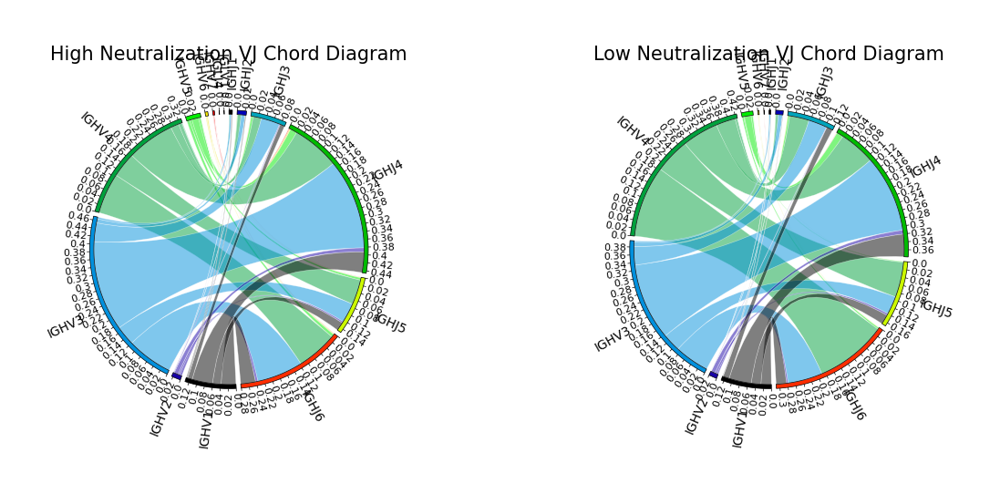

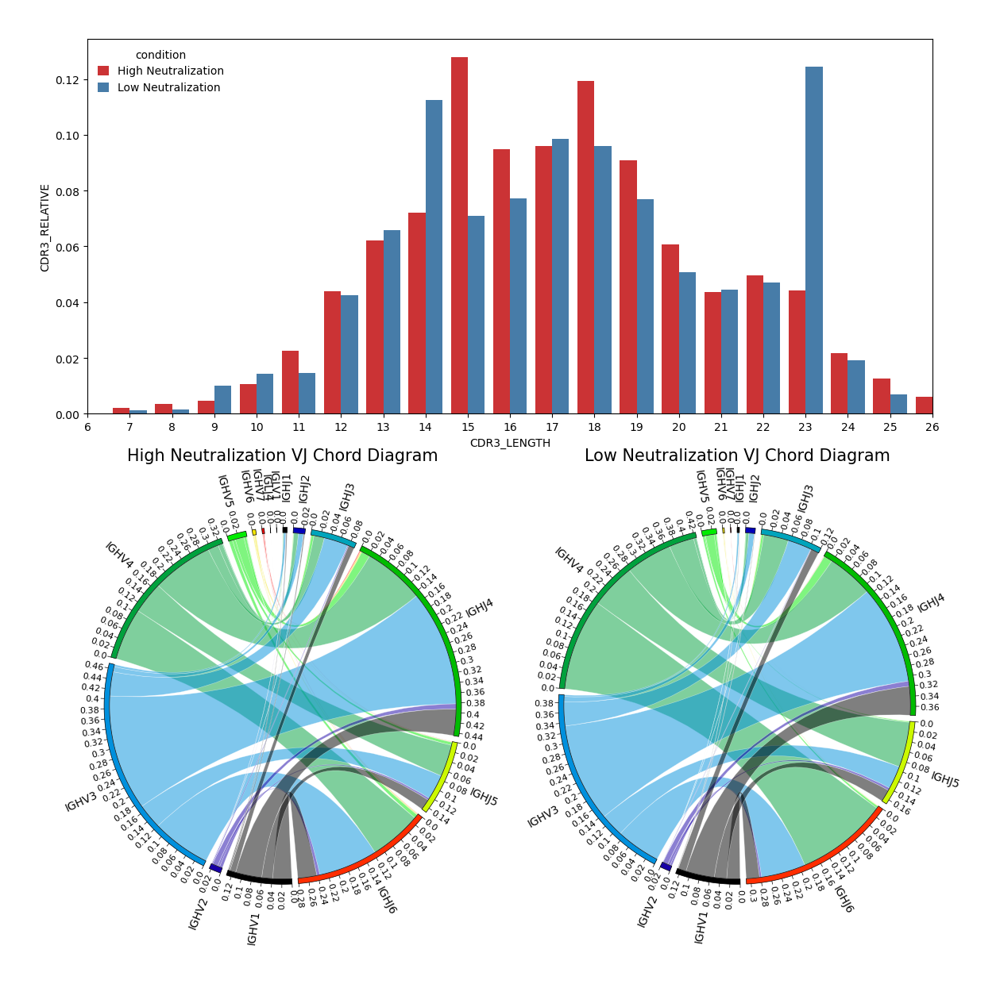

[('167ecf28-c395-40ed-9651-a7ef7d0784cb', 'Low Neutralization'), ('ad5489b5-6cff-4773-bb76-ec09b2573ff3', 'Cat. 1 High Neutralization')]


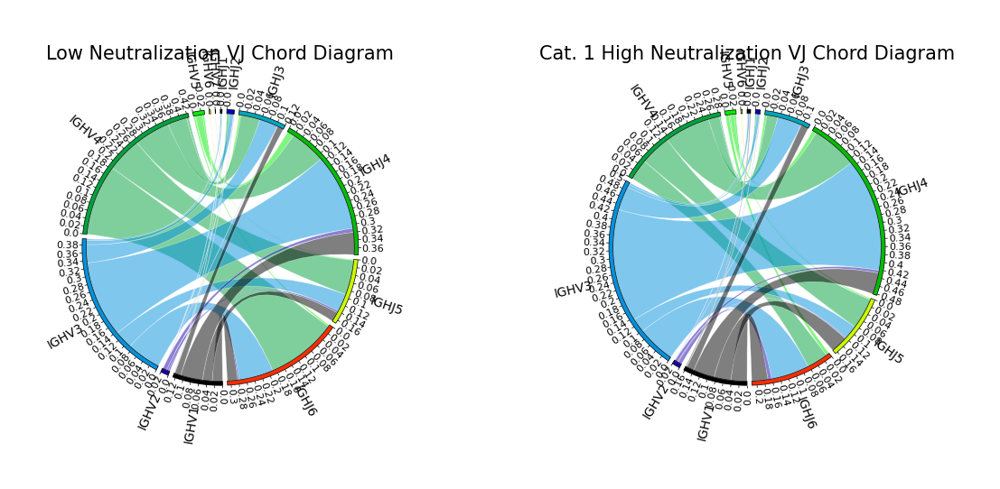

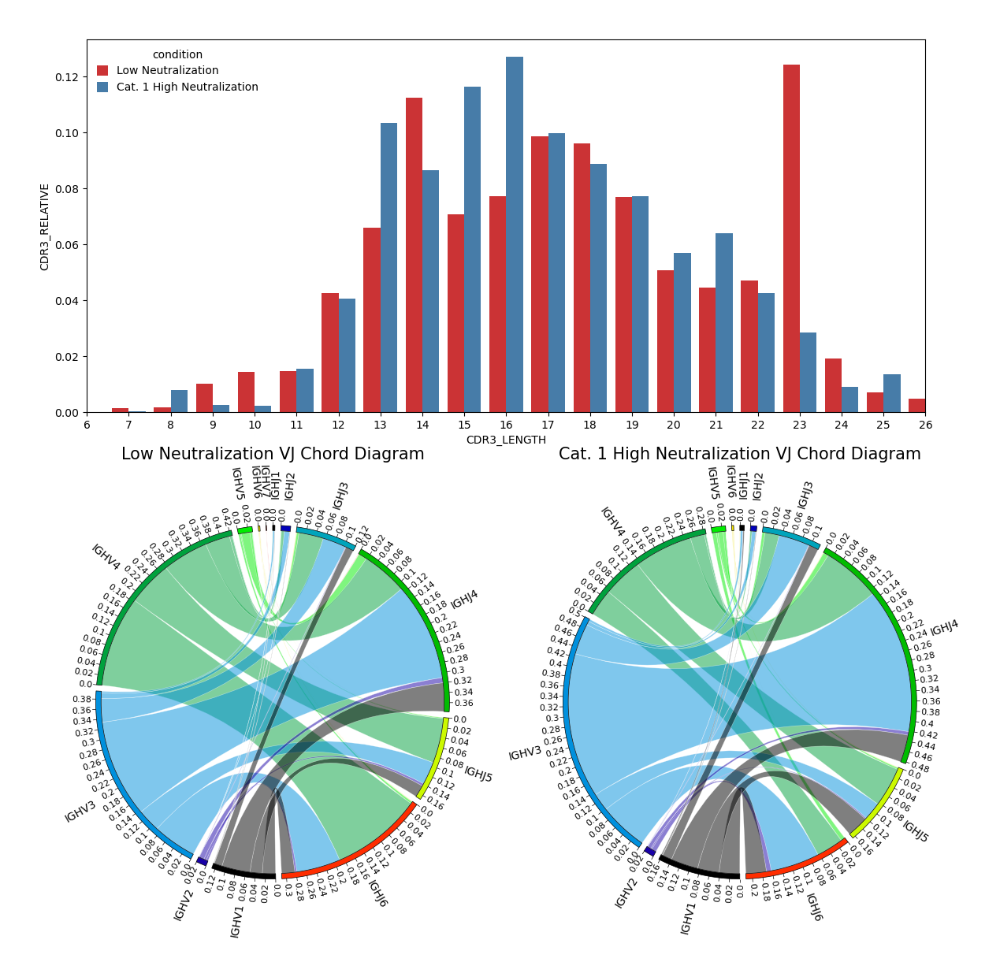

[('ad5489b5-6cff-4773-bb76-ec09b2573ff3', 'Cat. 1 High Neutralization'), ('08475c9e-efb6-4302-8bb1-77186b5b86b9', 'Cat. 1 Low Neutralization')]


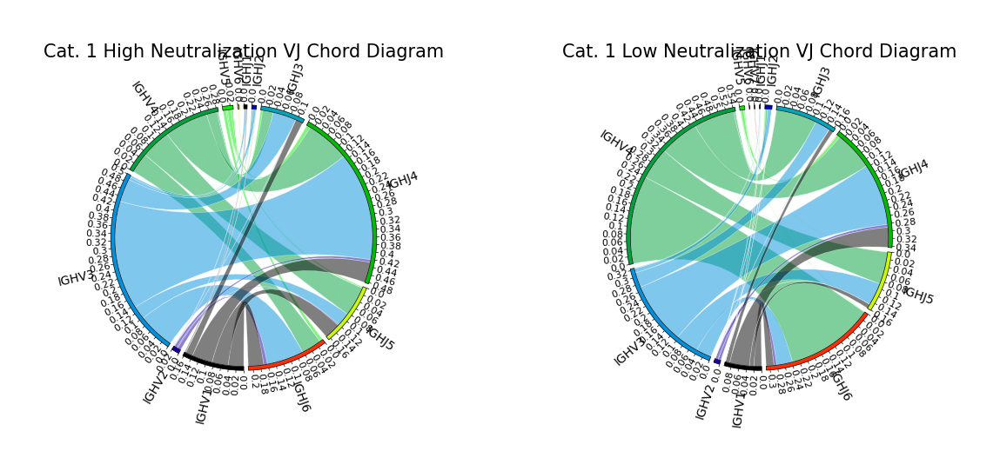

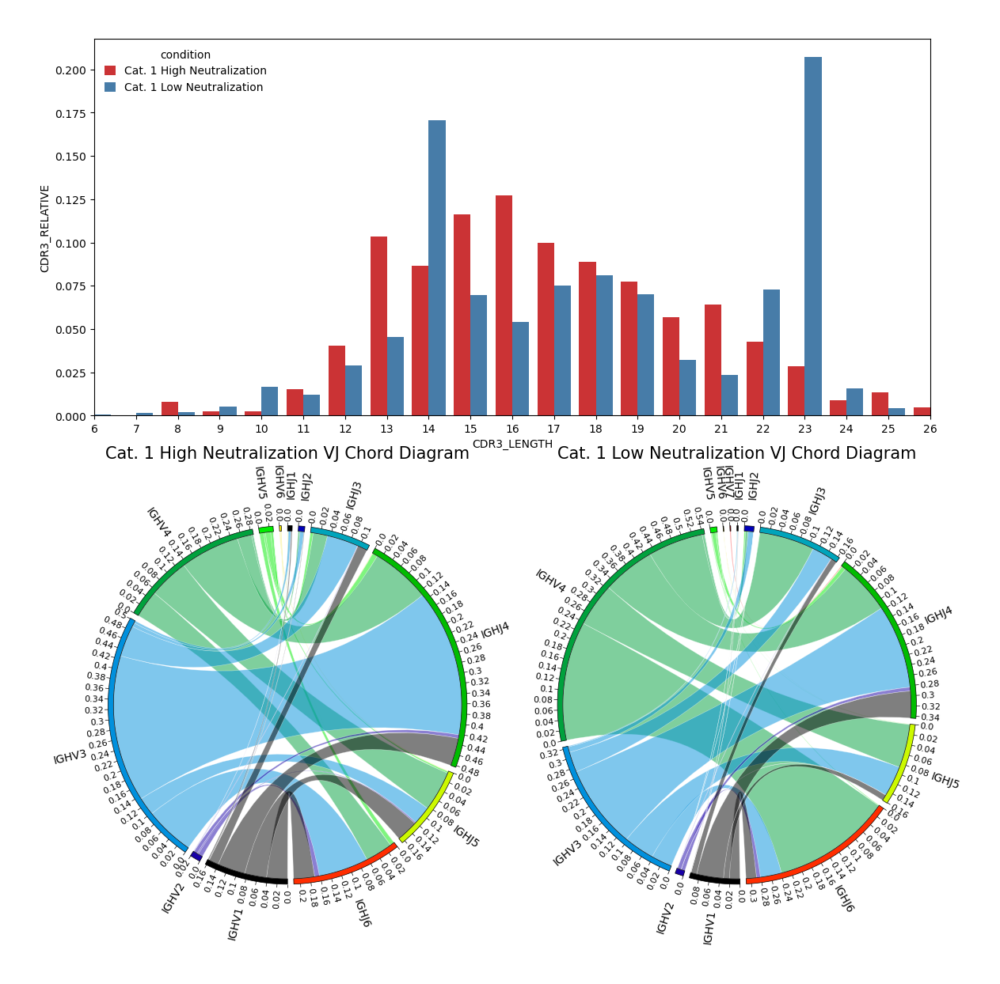

[('08475c9e-efb6-4302-8bb1-77186b5b86b9', 'Cat. 1 Low Neutralization'), ('1672807c-ba98-4ec4-aa96-e2023c4dd23a', 'Cat. 4-5 High Neutralization')]


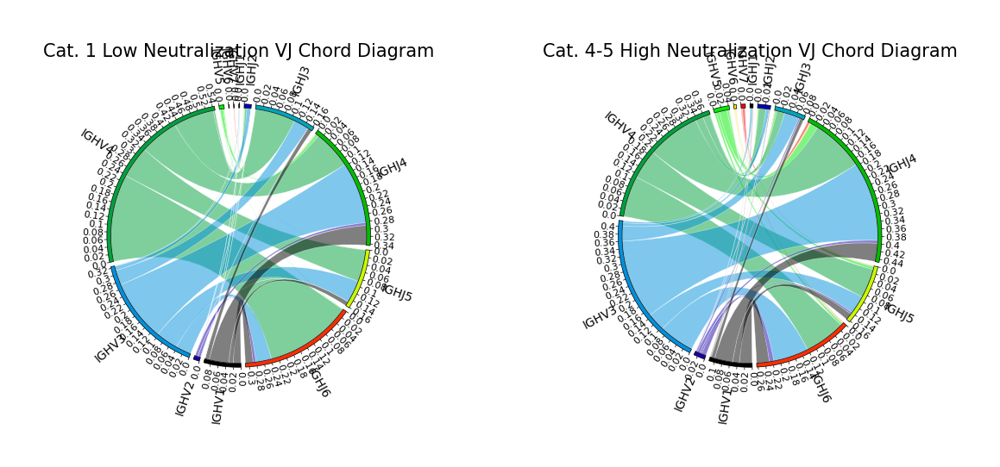

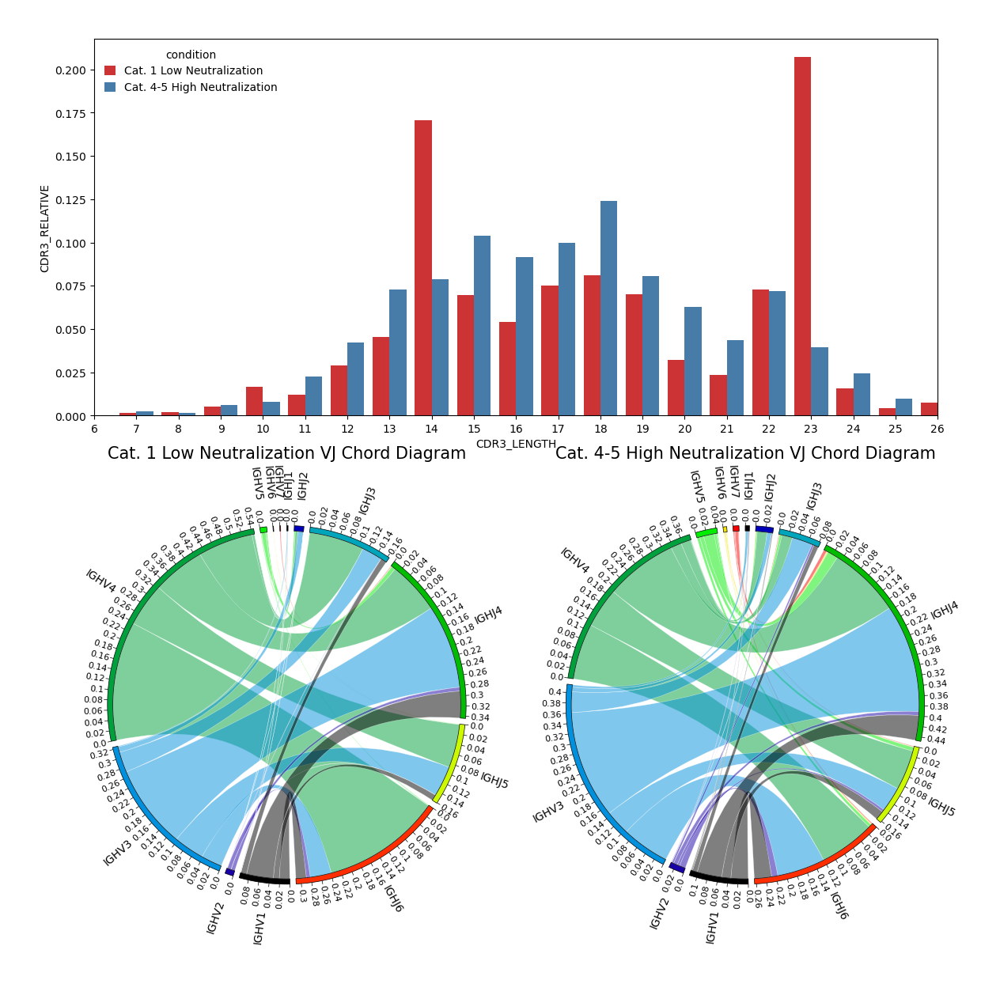

[('1672807c-ba98-4ec4-aa96-e2023c4dd23a', 'Cat. 4-5 High Neutralization'), ('2abdc4e5-dd79-4c39-b7b9-b4e8ee642ec1', 'Cat. 6 Low Neutralization')]


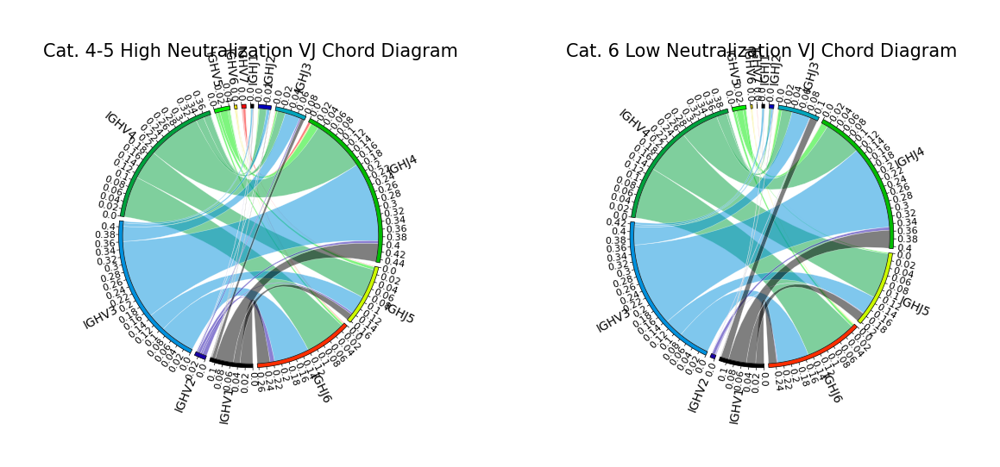

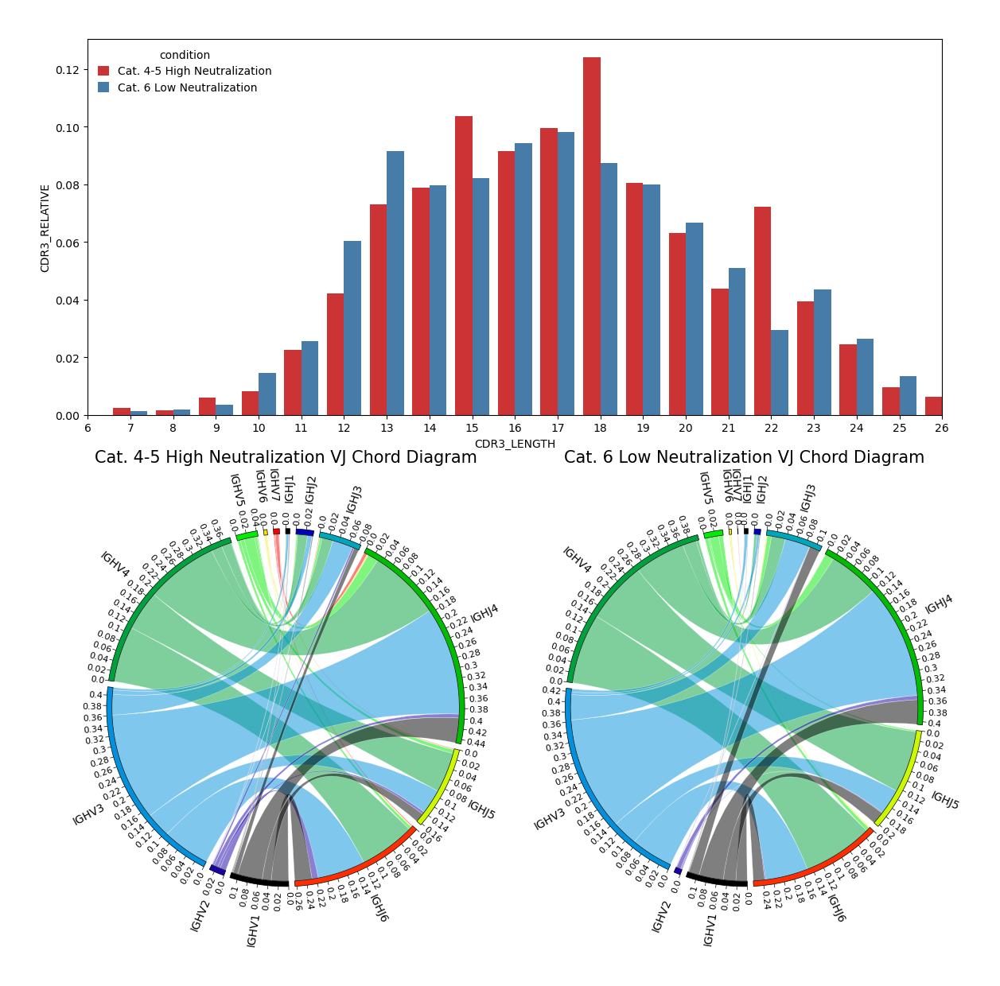

[('2abdc4e5-dd79-4c39-b7b9-b4e8ee642ec1', 'Cat. 6 Low Neutralization'), ('fece9f9e-b20e-4df2-bd24-fc4e8cc213d3', 'Cat. 6 High Neutralization')]


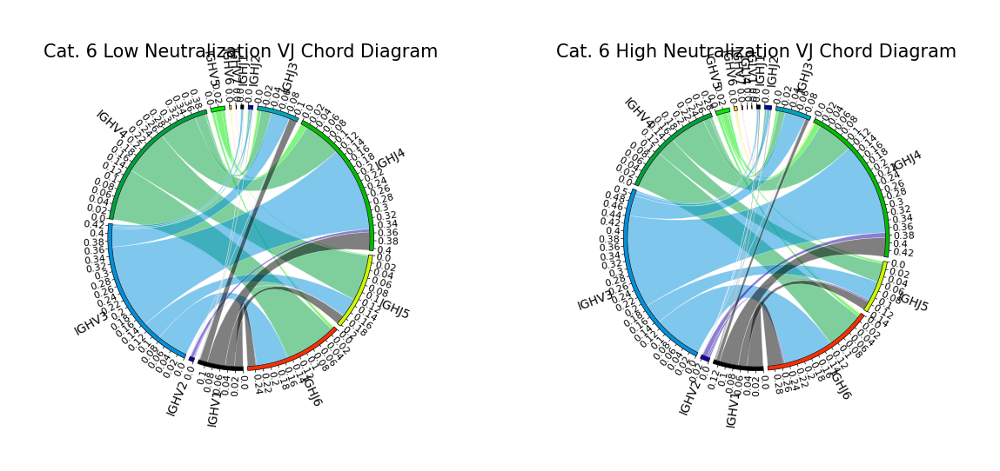

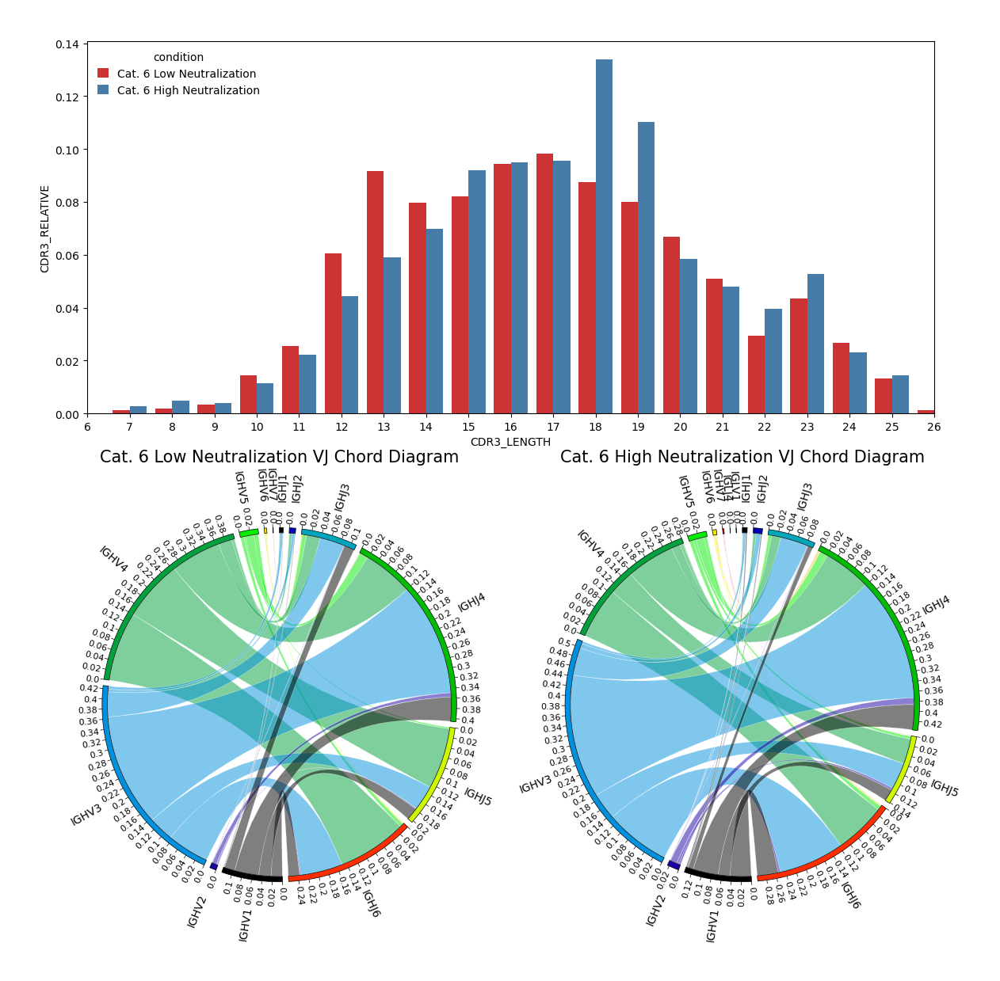

[('fece9f9e-b20e-4df2-bd24-fc4e8cc213d3', 'Cat. 6 High Neutralization'), ('3621f37f-2b34-478b-af42-ef1fb1f7e799', 'Cat. 7 High Neutralization')]


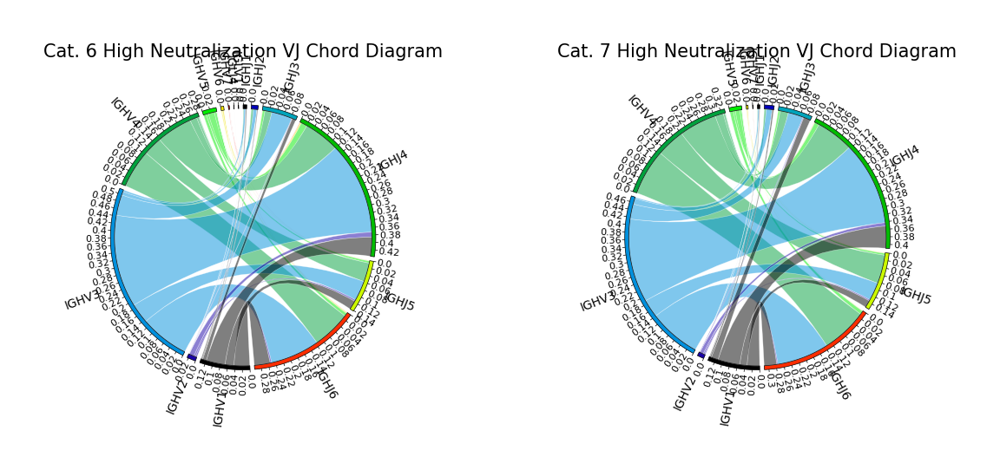

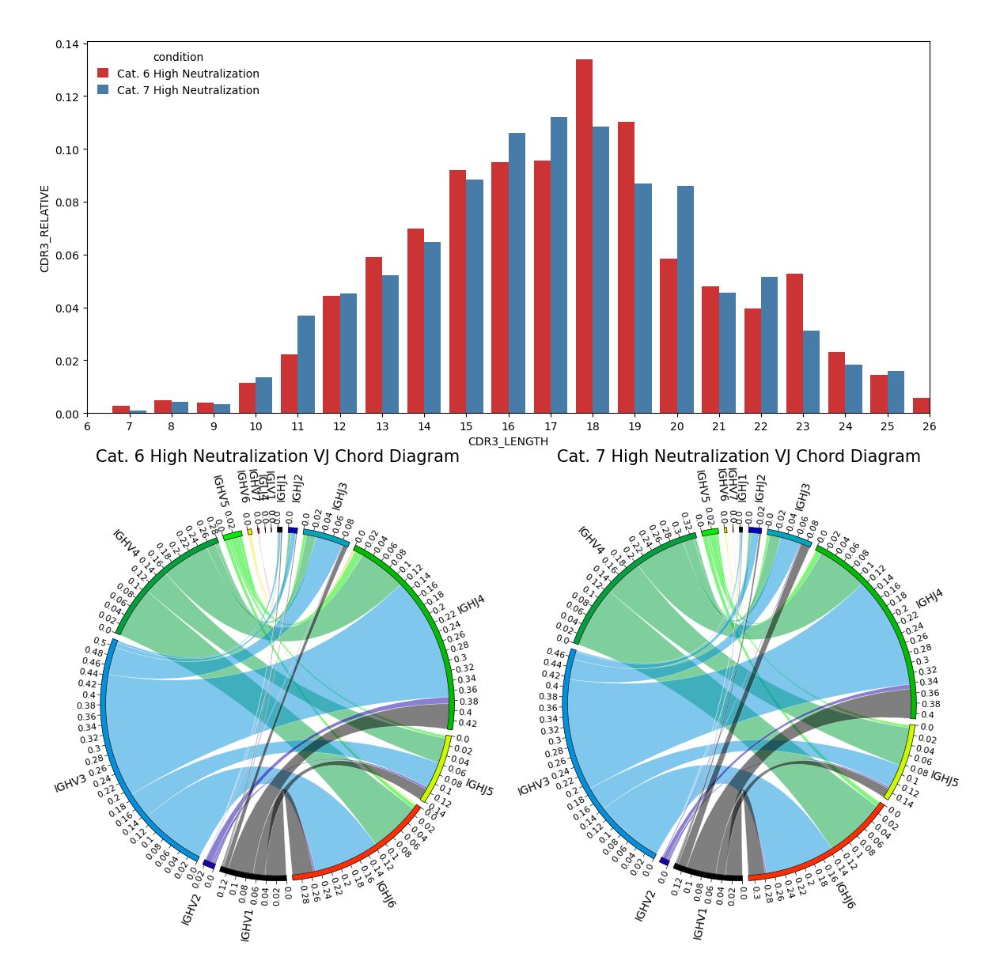

[('3621f37f-2b34-478b-af42-ef1fb1f7e799', 'Cat. 7 High Neutralization'), ('540bc5f1-2a71-4dbc-833f-e01e562e7e03', 'Cat. 2-7 Low Neutralization')]


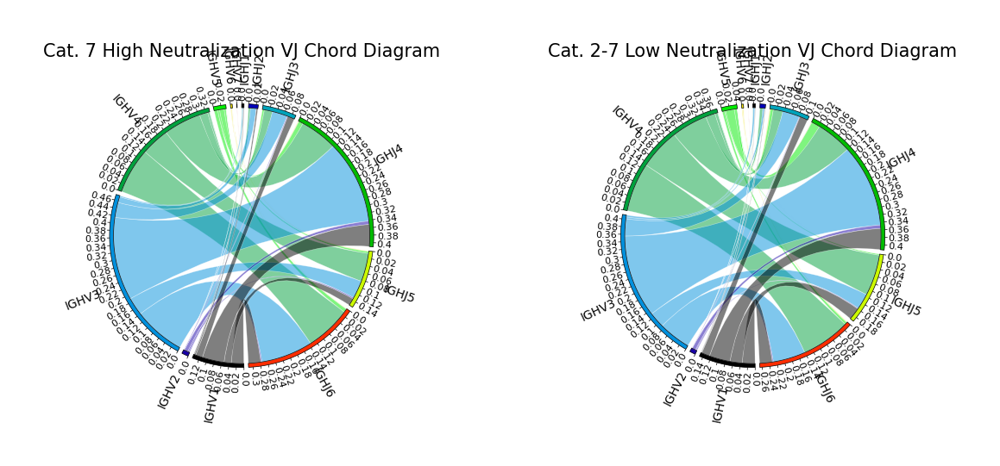

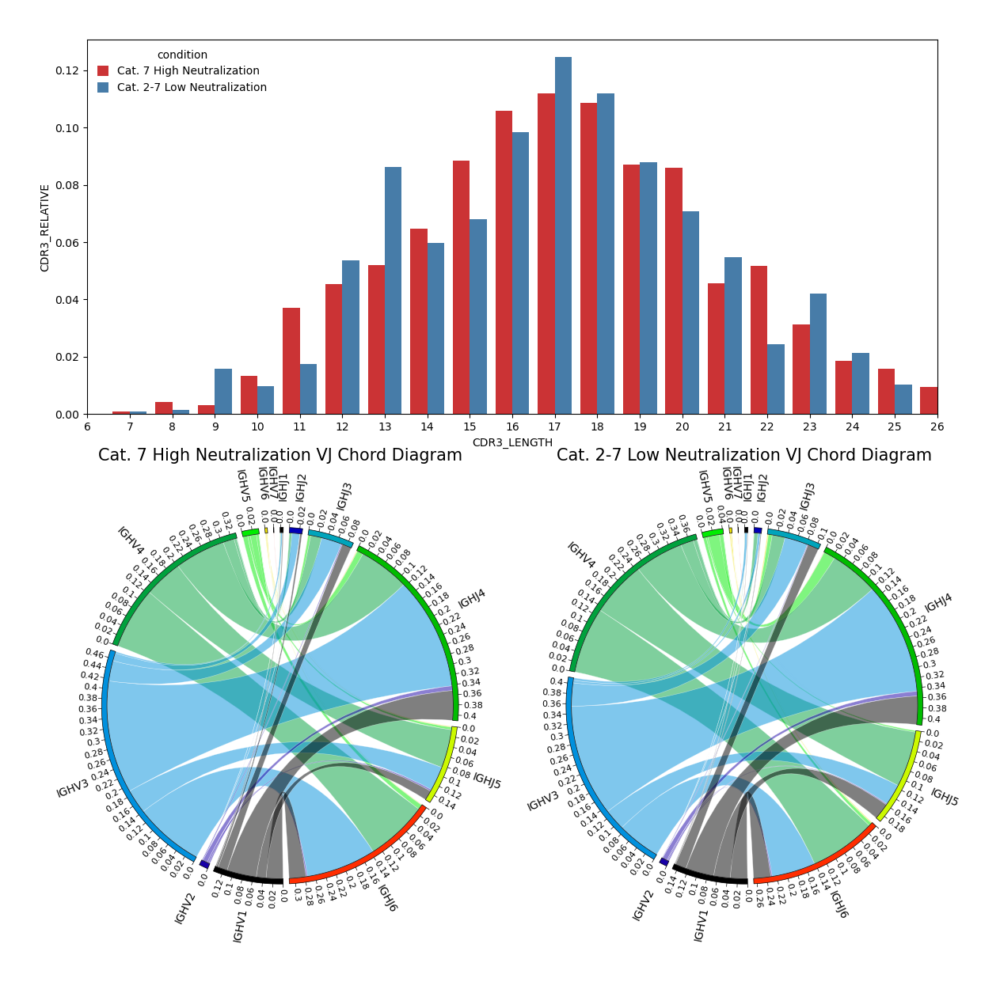

[('540bc5f1-2a71-4dbc-833f-e01e562e7e03', 'Cat. 2-7 Low Neutralization'), ('a57c907d-39aa-407c-99df-9c105d43407d', 'Cat. 2-7 High Neutralization')]


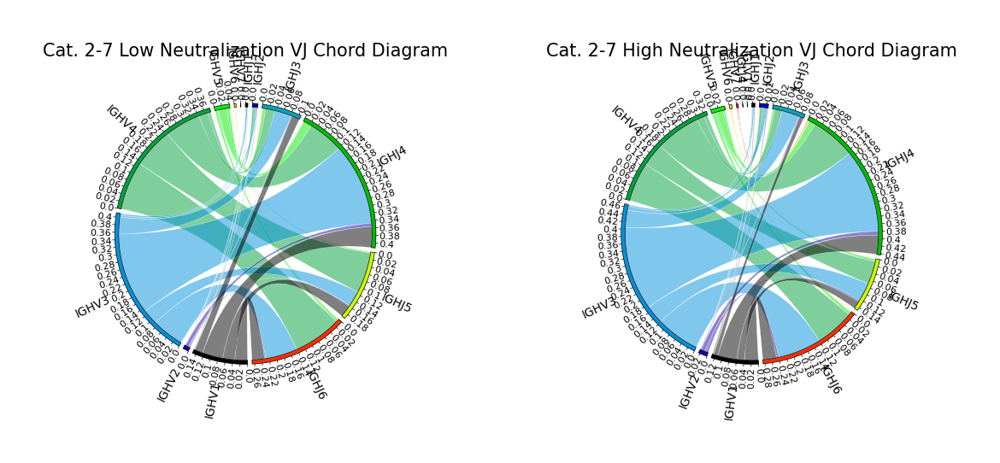

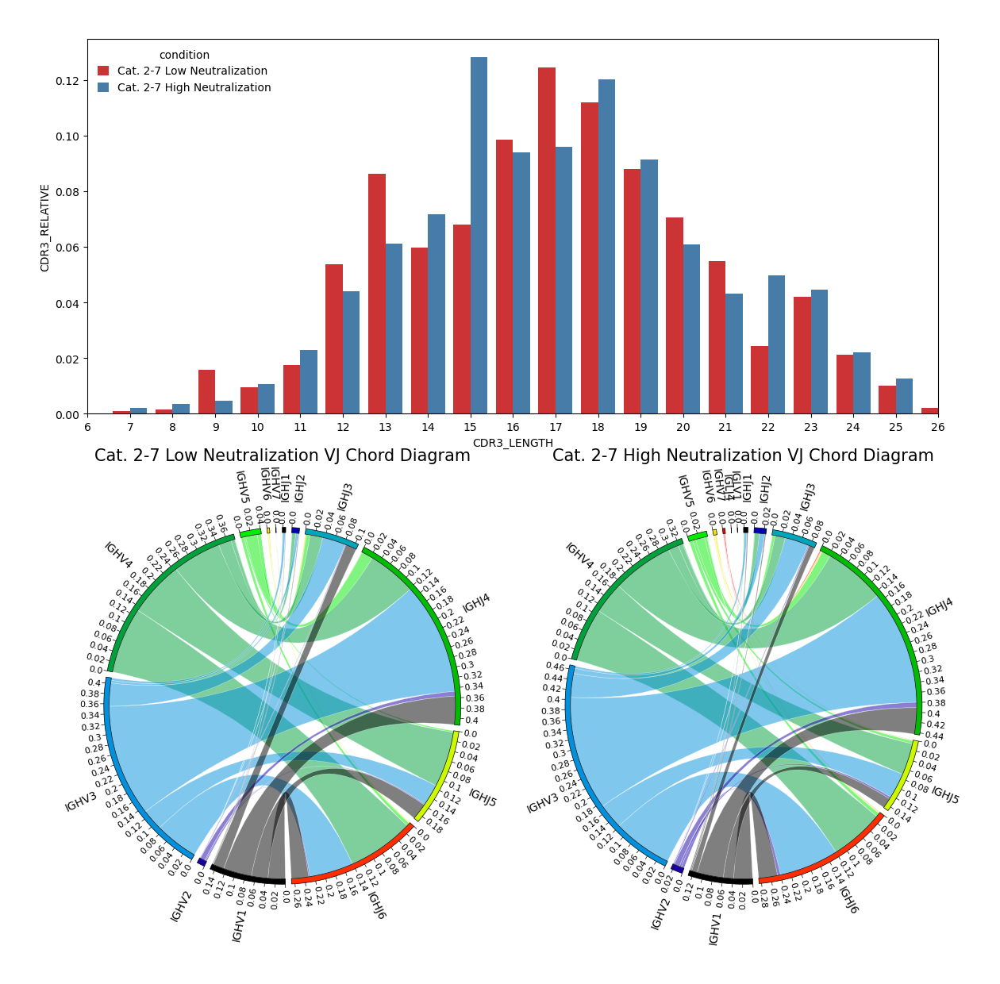

[('a57c907d-39aa-407c-99df-9c105d43407d', 'Cat. 2-7 High Neutralization'), ('523b4d12-eb73-4a29-bbdd-ebe17576554f', 'Healthy Control')]


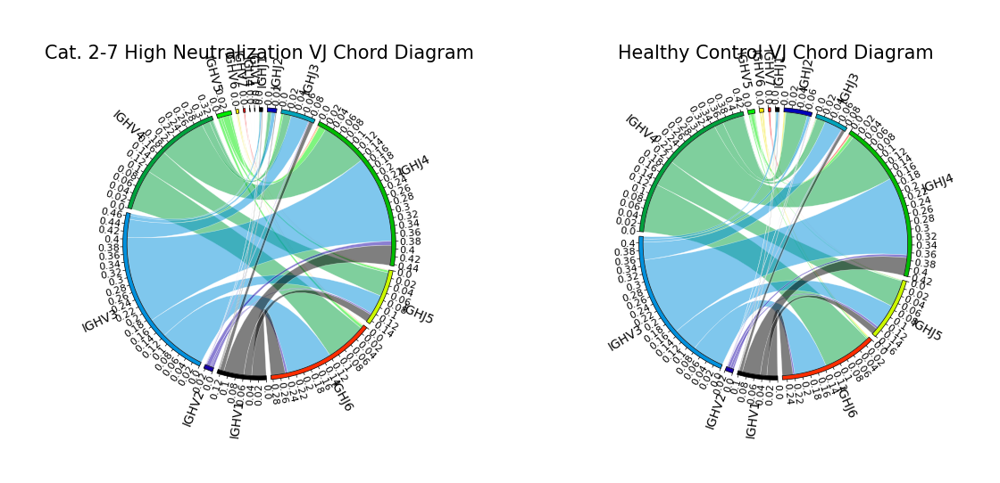

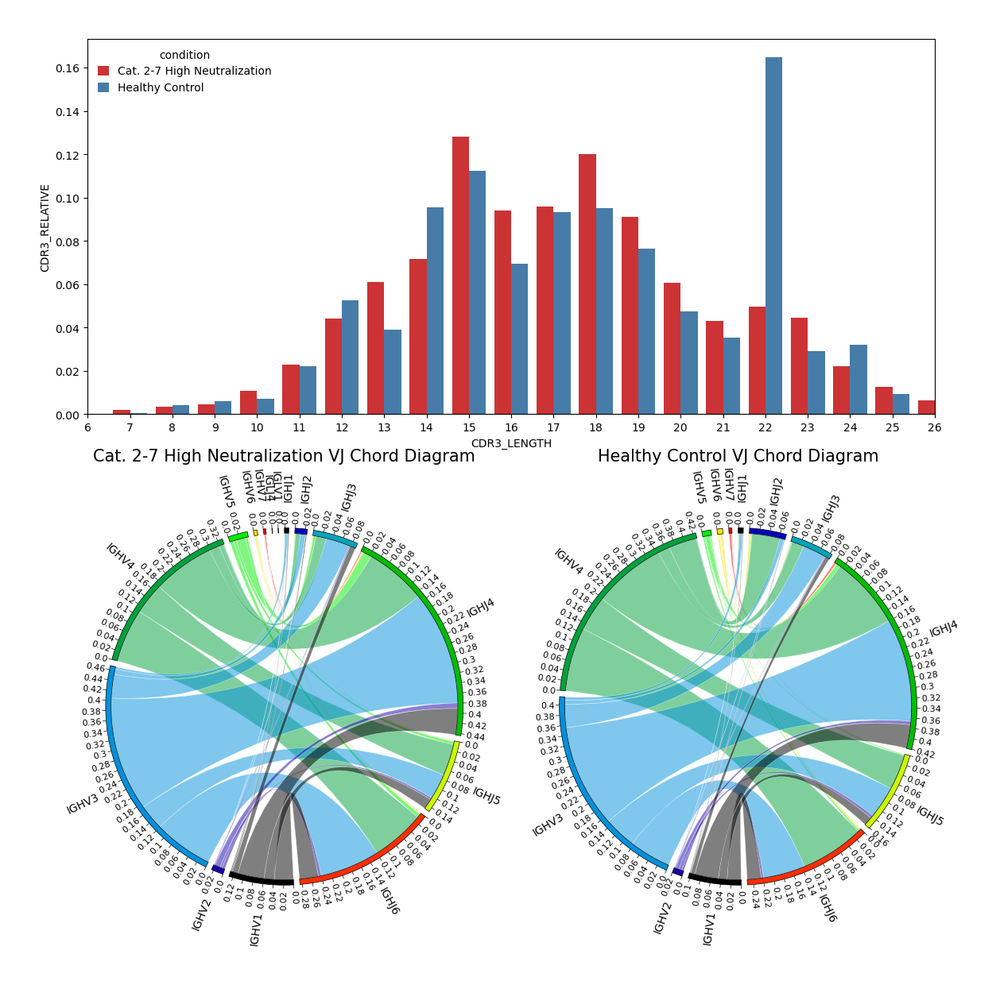

[('523b4d12-eb73-4a29-bbdd-ebe17576554f', 'Healthy Control'), ('8a1cd1bd-9279-4cb7-883a-1b8ad7f0764f', 'Heme Cancer')]


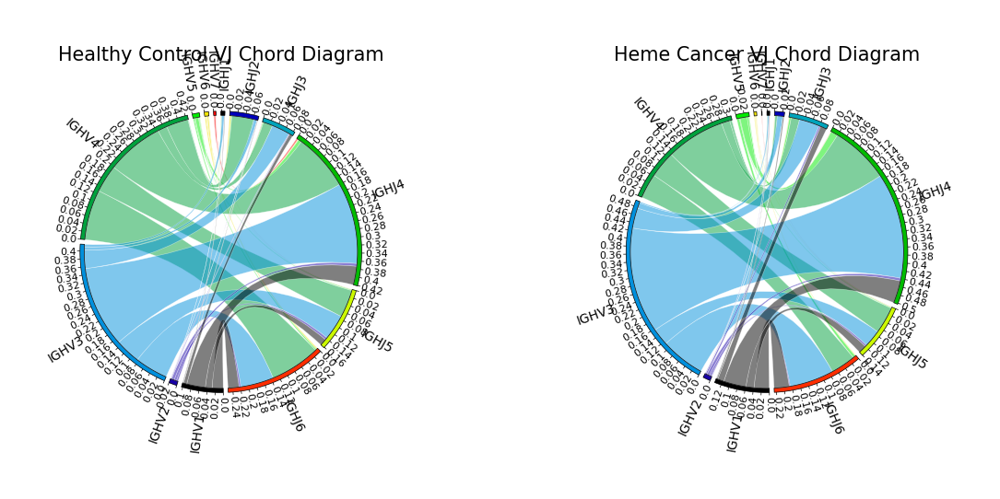

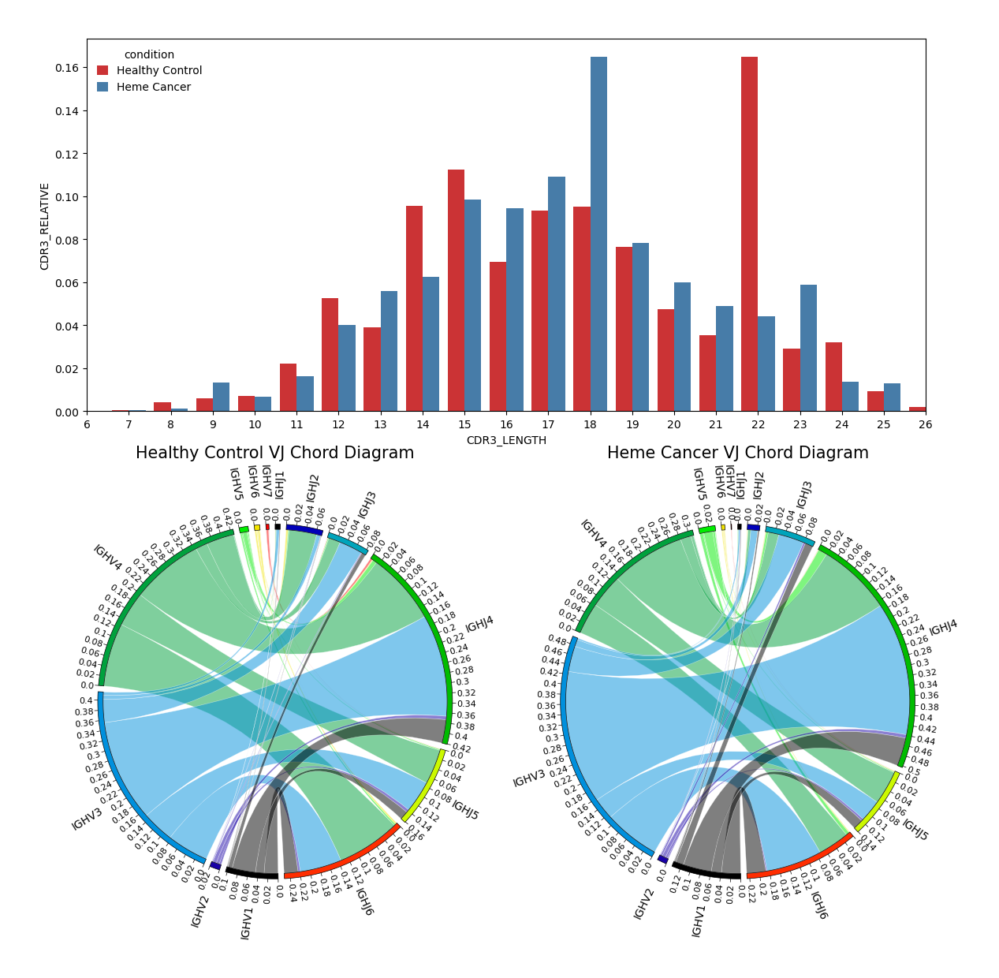

[('8a1cd1bd-9279-4cb7-883a-1b8ad7f0764f', 'Heme Cancer'), ('d262632b-51d7-49f9-9505-d7ac839f6938', 'Neuroimmunology')]


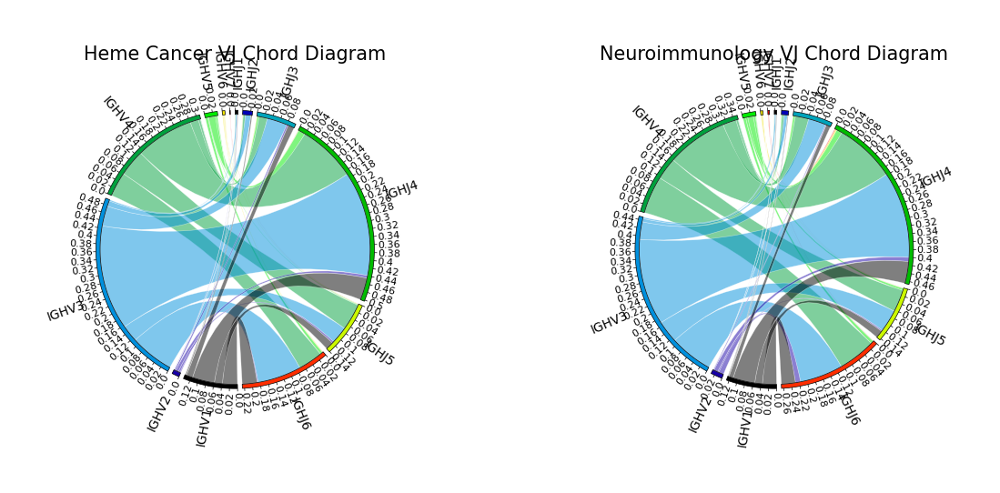

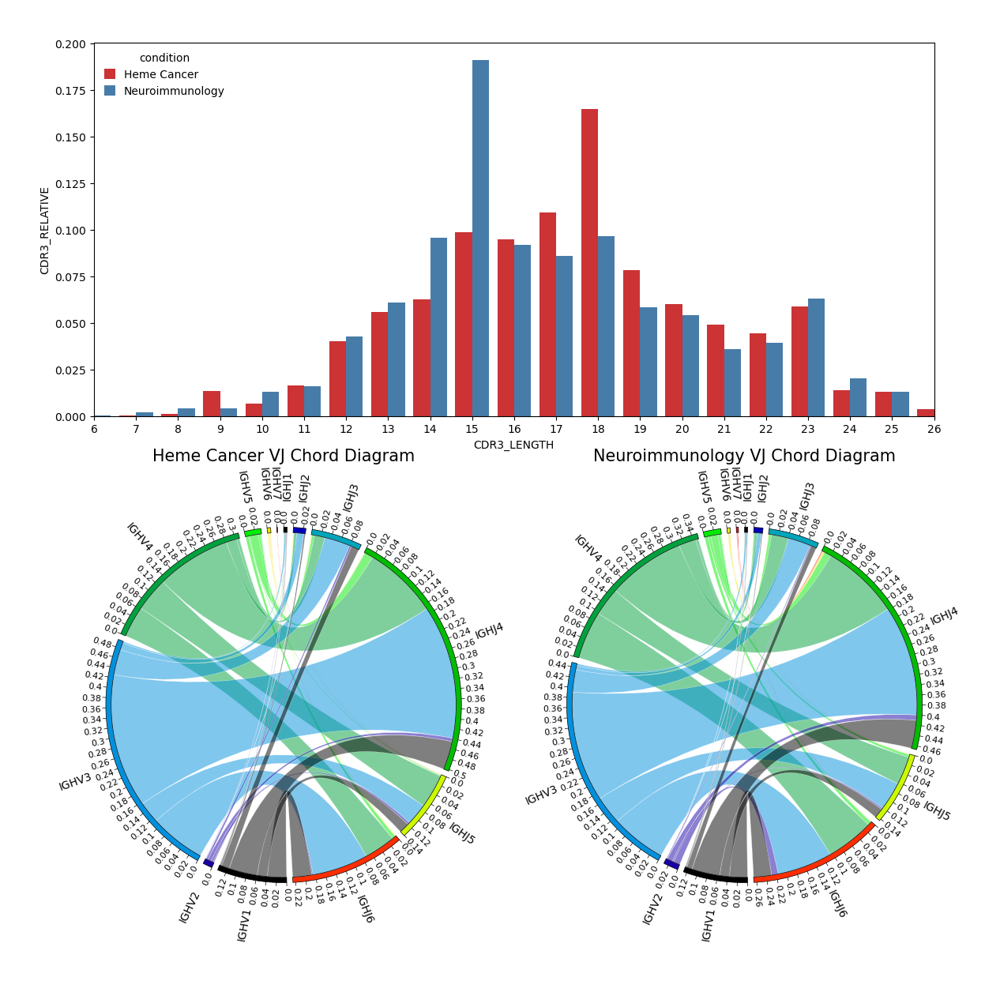

[('d262632b-51d7-49f9-9505-d7ac839f6938', 'Neuroimmunology'), ('ffb943d1-7afa-484d-88f2-3dd2efc0b102', 'Solid Cancer')]


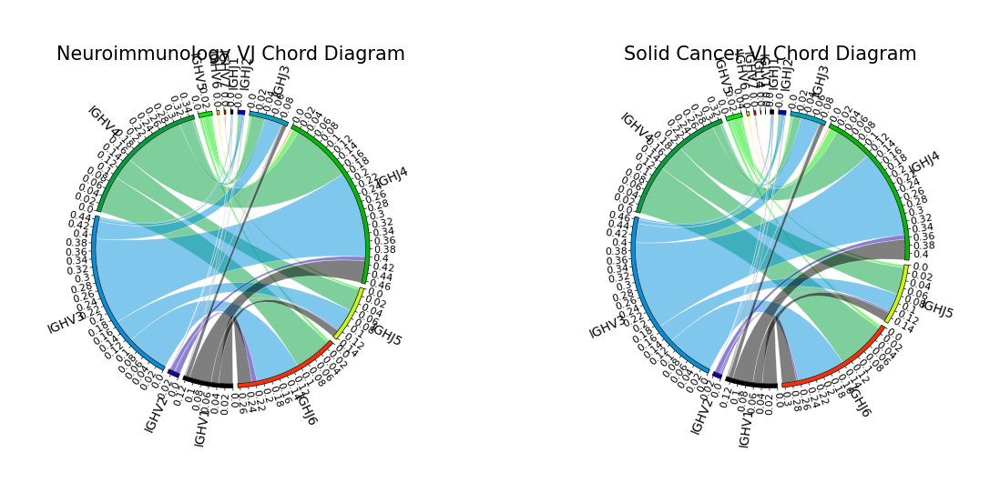

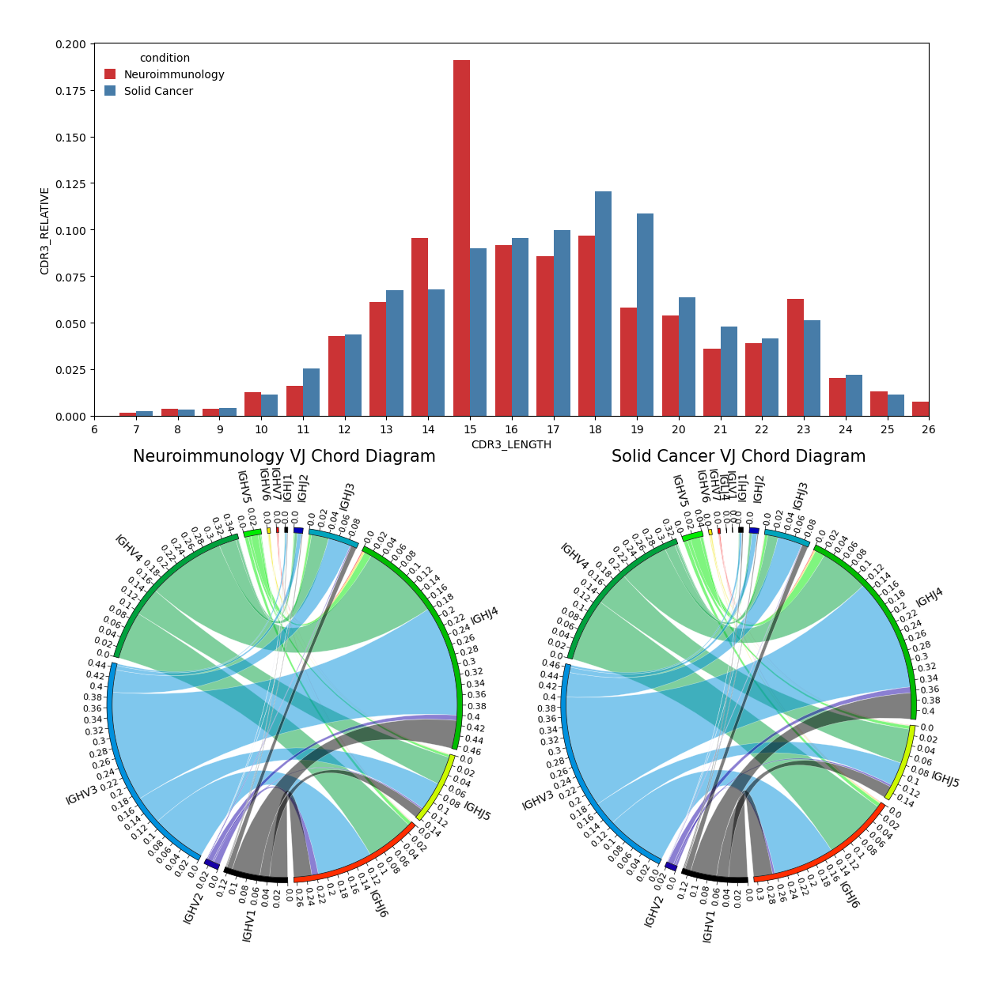

[('ffb943d1-7afa-484d-88f2-3dd2efc0b102', 'Solid Cancer'), ('67e77903-4ee3-4e54-9690-acf4a316a7a4', 'Healthy Control Low Neutralization')]


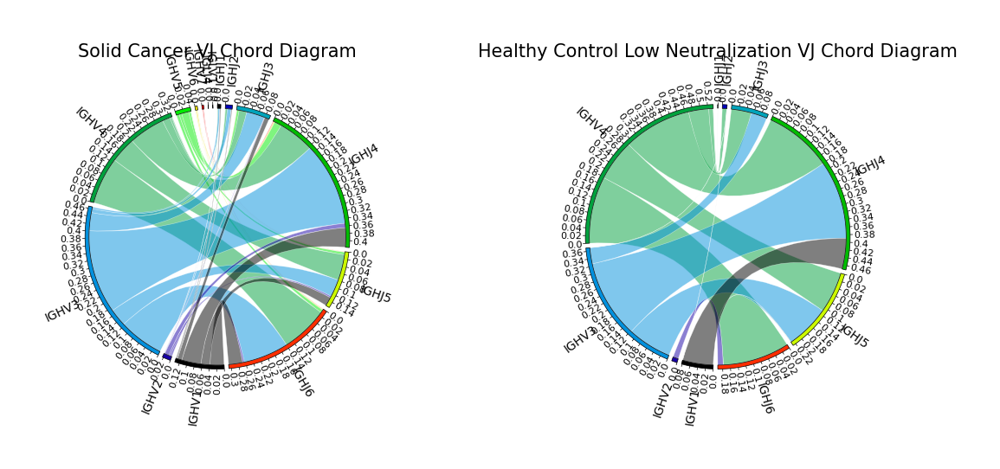

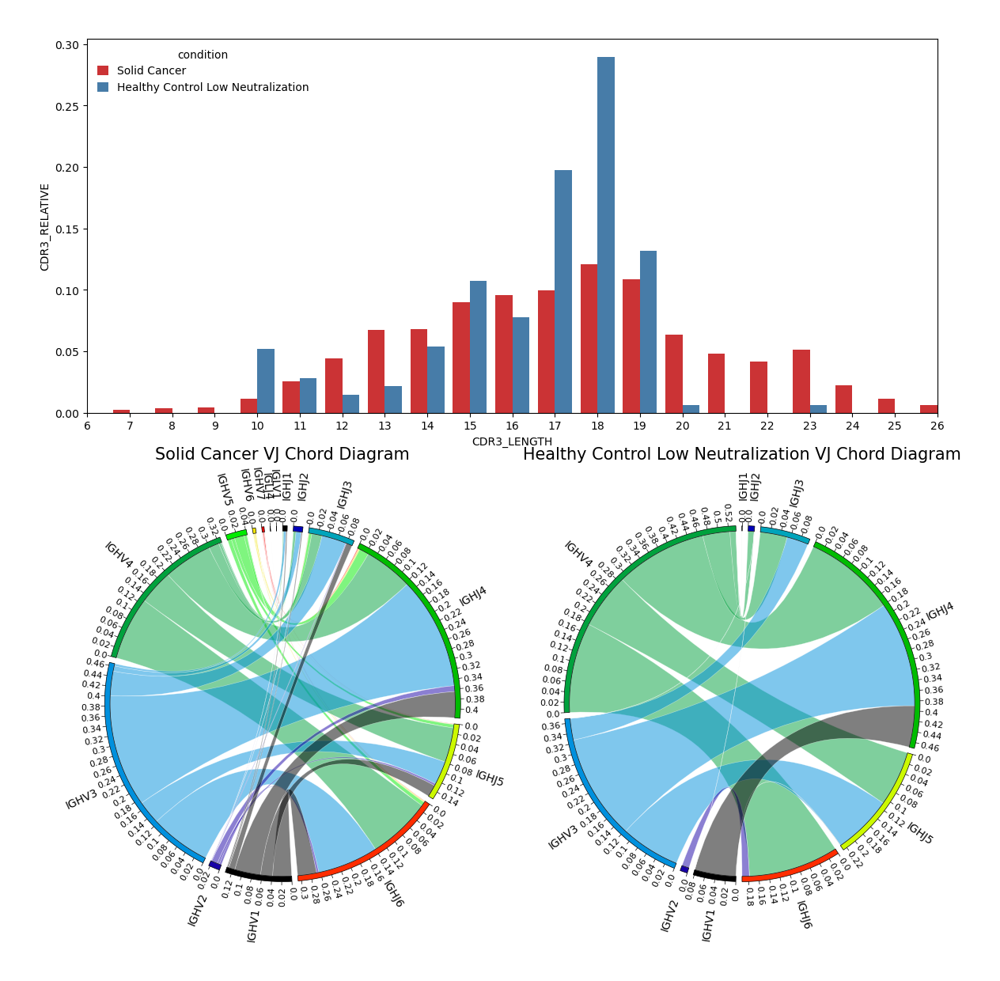

[('67e77903-4ee3-4e54-9690-acf4a316a7a4', 'Healthy Control Low Neutralization'), ('3357bc71-0423-495e-9745-b159398e84ec', 'Healthy Control High Neutralization')]


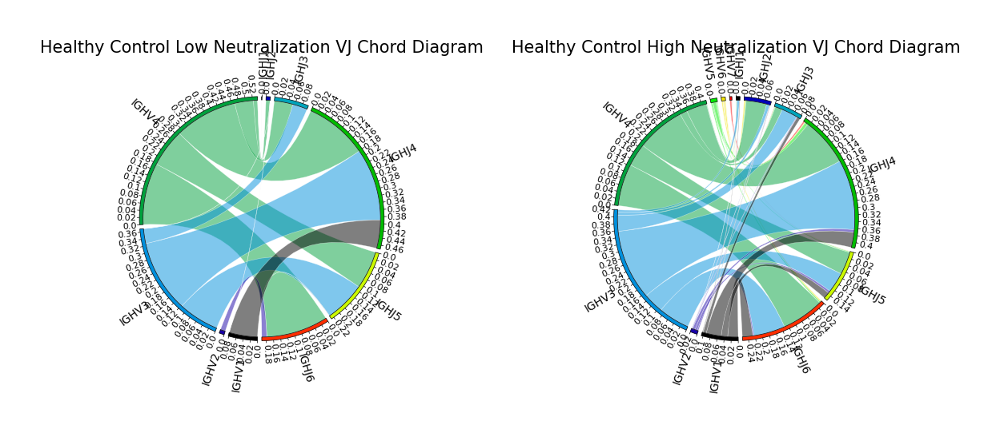

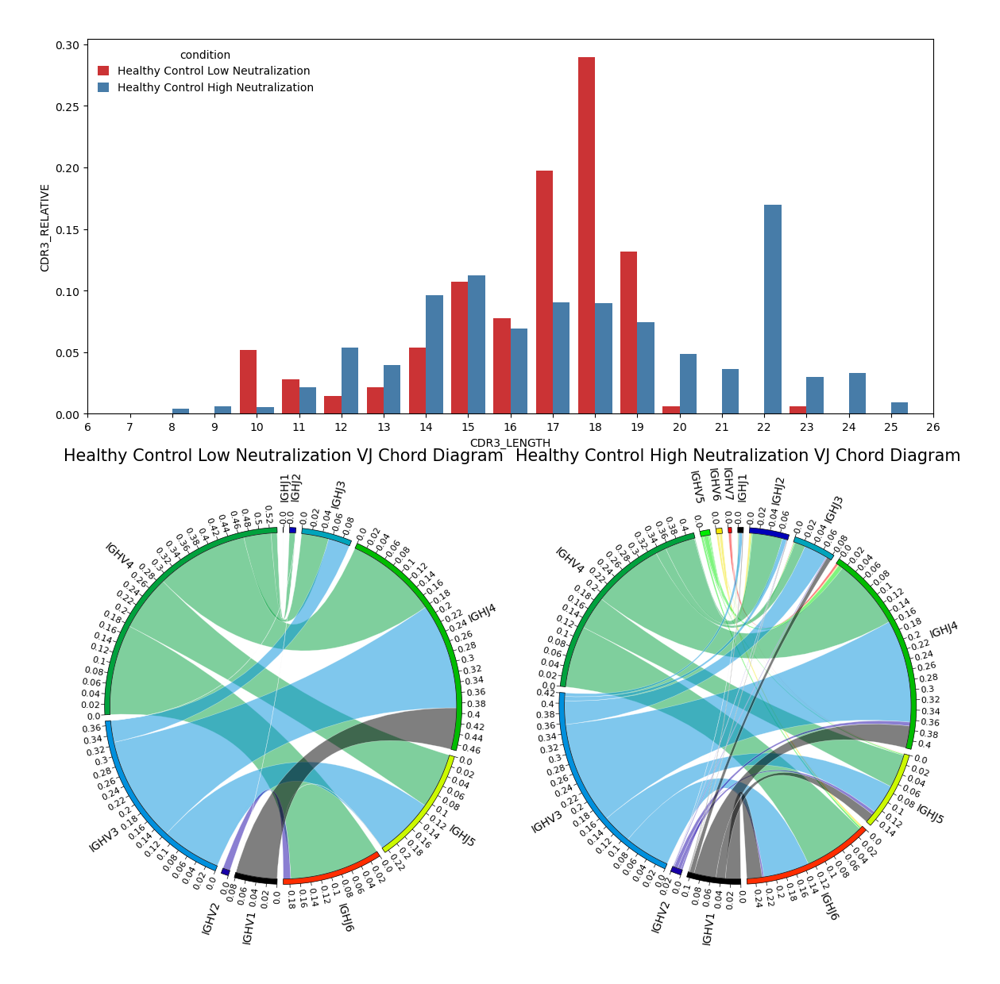

[('3357bc71-0423-495e-9745-b159398e84ec', 'Healthy Control High Neutralization'), ('fa463db5-ed68-4d31-8618-90b12143c7f5', 'Heme Cancer High Neutralization')]


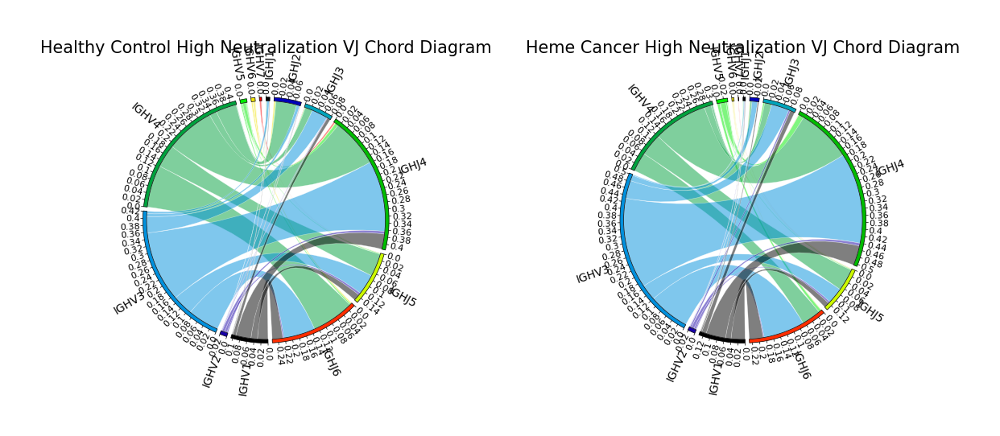

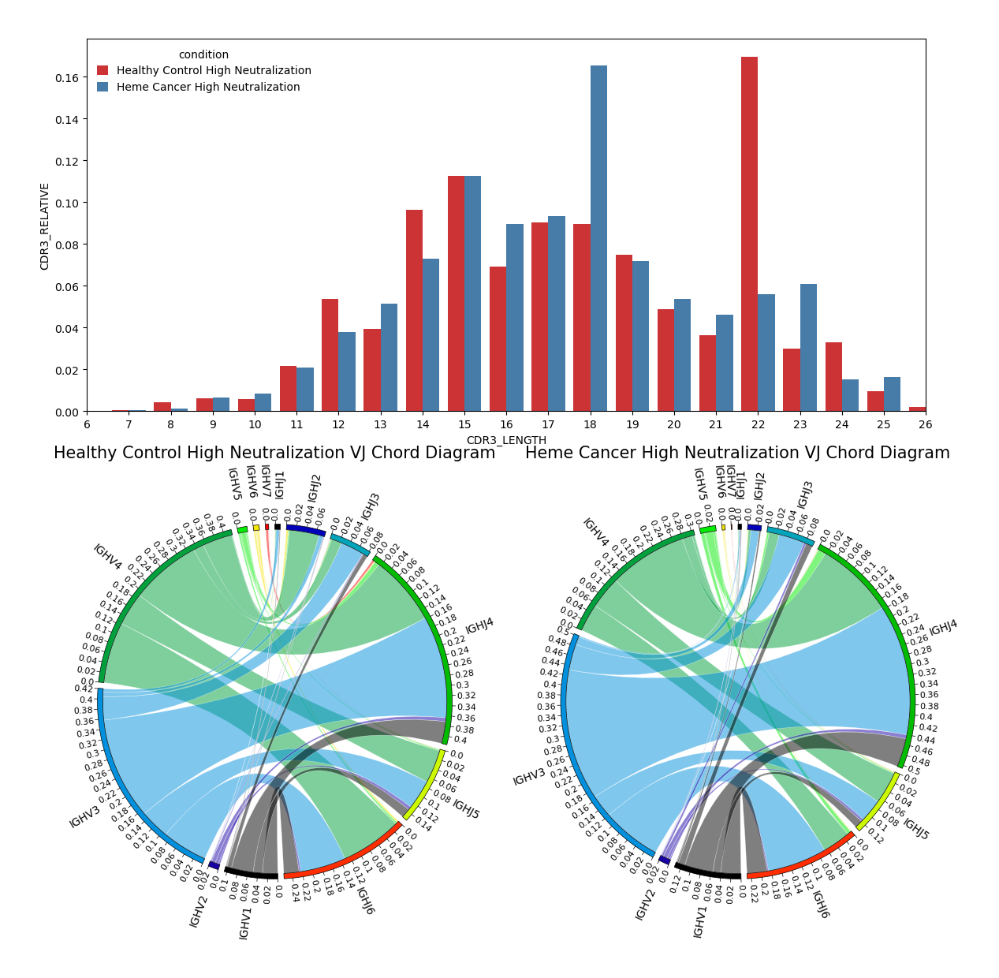

[('fa463db5-ed68-4d31-8618-90b12143c7f5', 'Heme Cancer High Neutralization'), ('8e179bce-73ba-4f3f-92b7-5076aeea02a3', 'Heme Cancer Low Neutralization')]


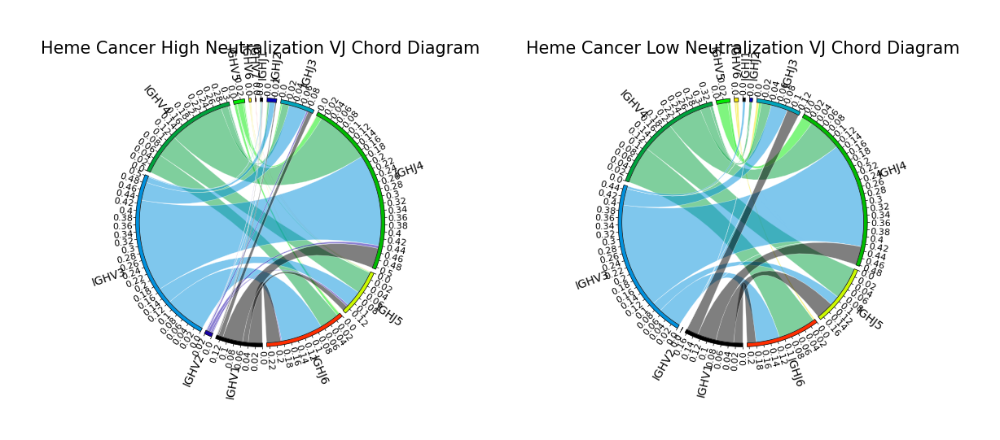

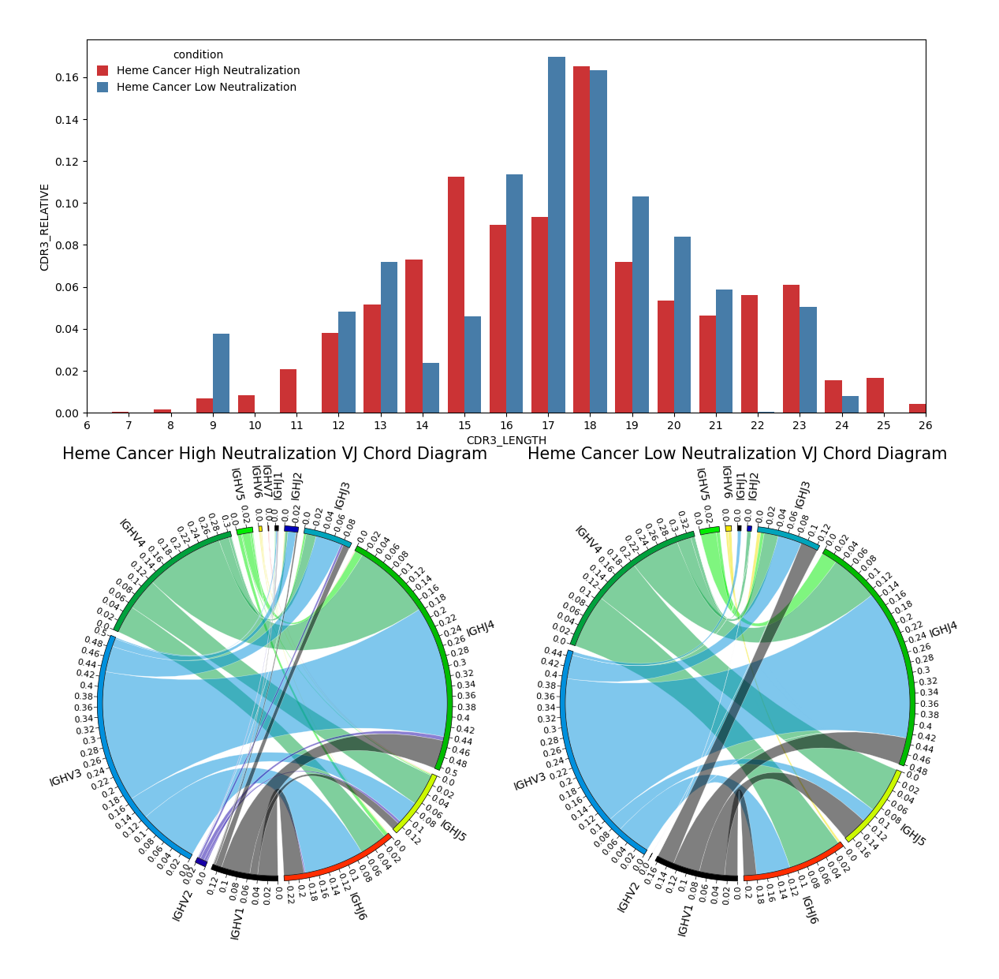

[('8e179bce-73ba-4f3f-92b7-5076aeea02a3', 'Heme Cancer Low Neutralization'), ('bf73e138-0ac8-4a80-b6ac-bb8b1461d212', 'Neuroimmunology High Neutralization')]


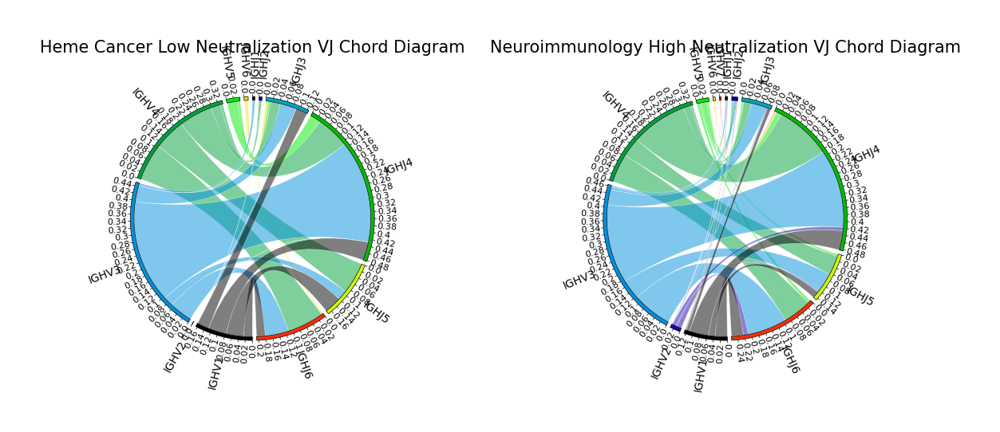

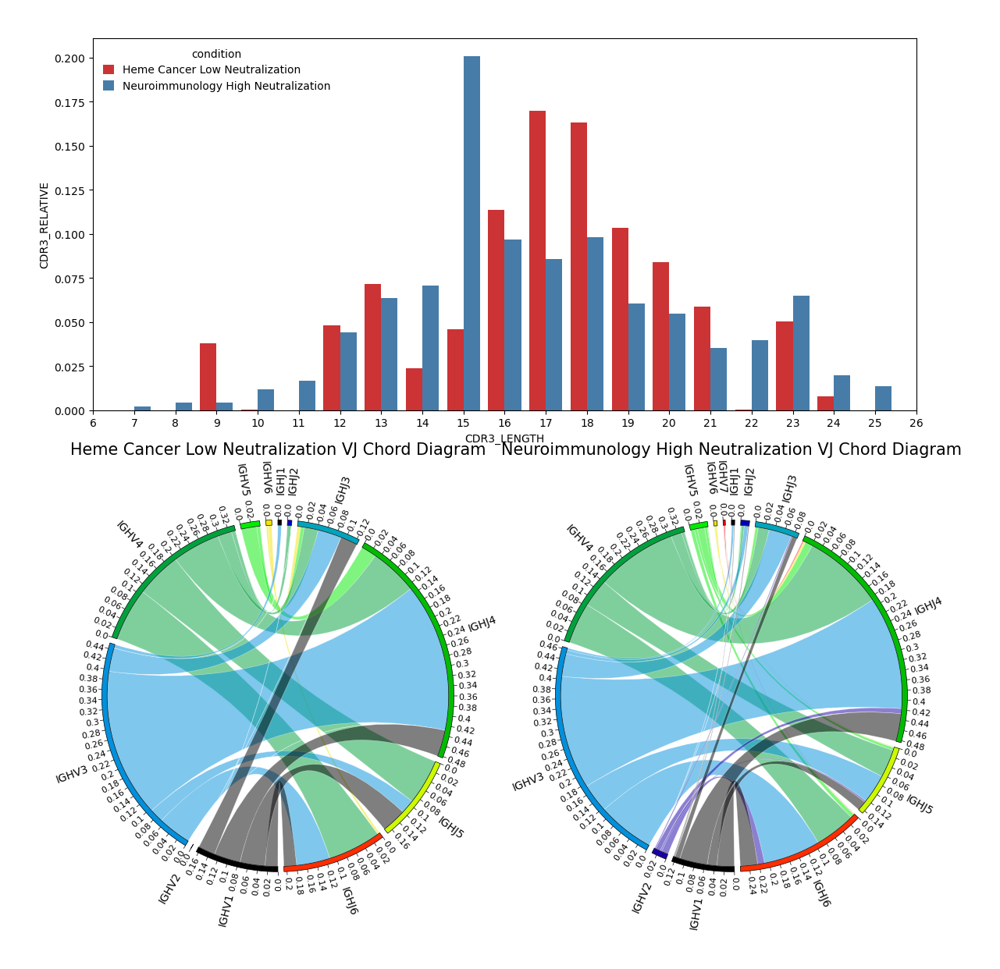

[('bf73e138-0ac8-4a80-b6ac-bb8b1461d212', 'Neuroimmunology High Neutralization'), ('2e3b2bc3-885c-4a8d-8f0a-f5924a9a9f4a', 'Neuroimmunology Low Neutralizatoin')]


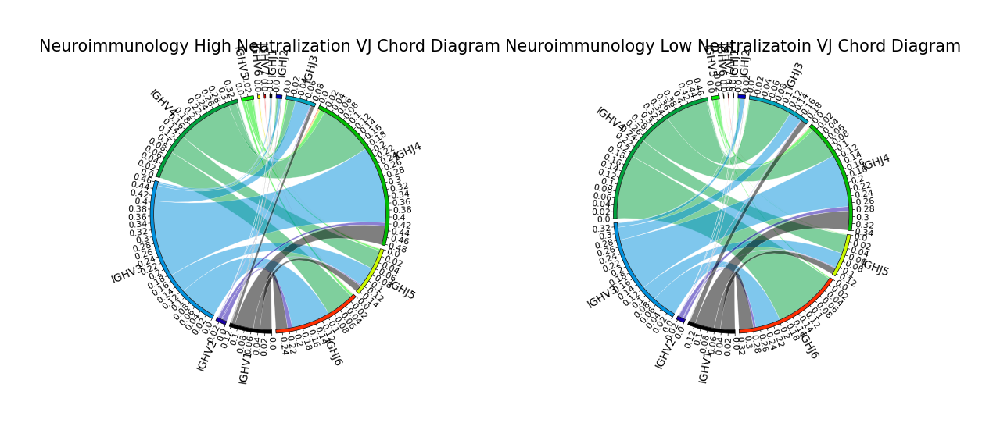

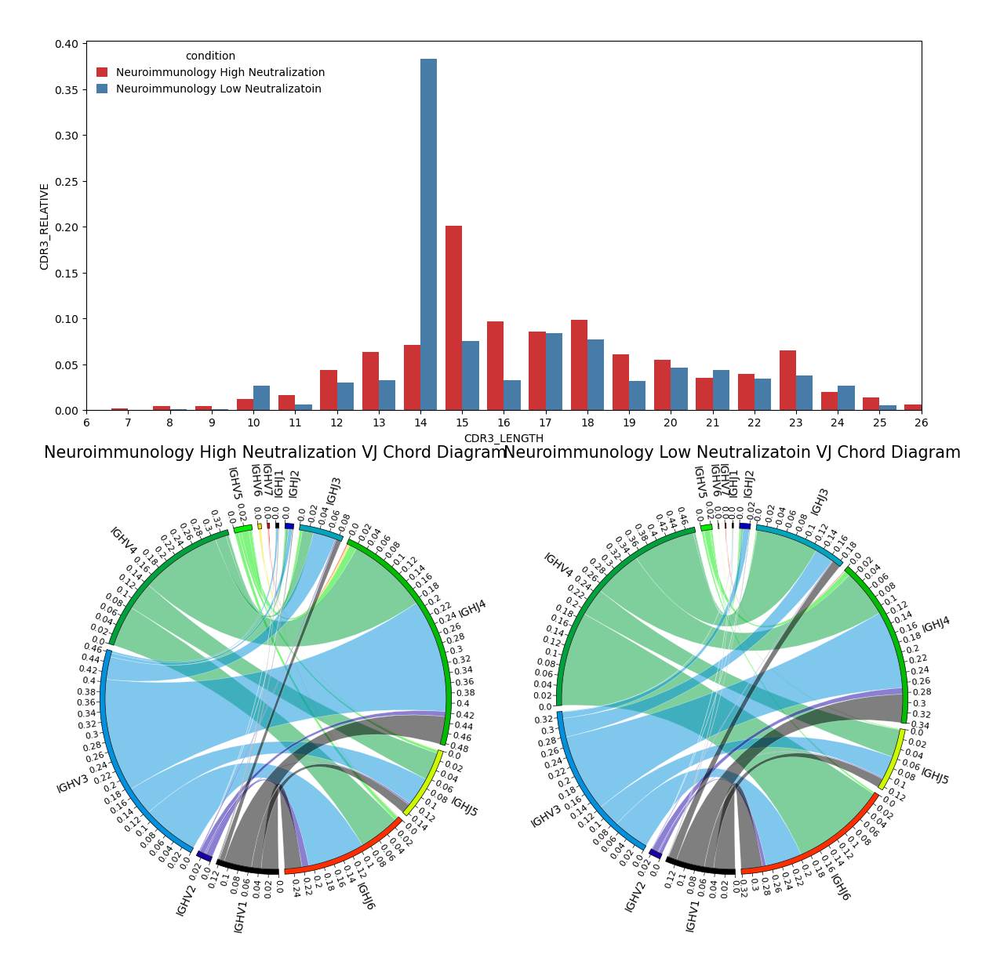

[('2e3b2bc3-885c-4a8d-8f0a-f5924a9a9f4a', 'Neuroimmunology Low Neutralizatoin'), ('5bdeb2de-e95f-4fb0-94ee-6ef9c319ddb4', 'Solid Cancer High Neutralization')]


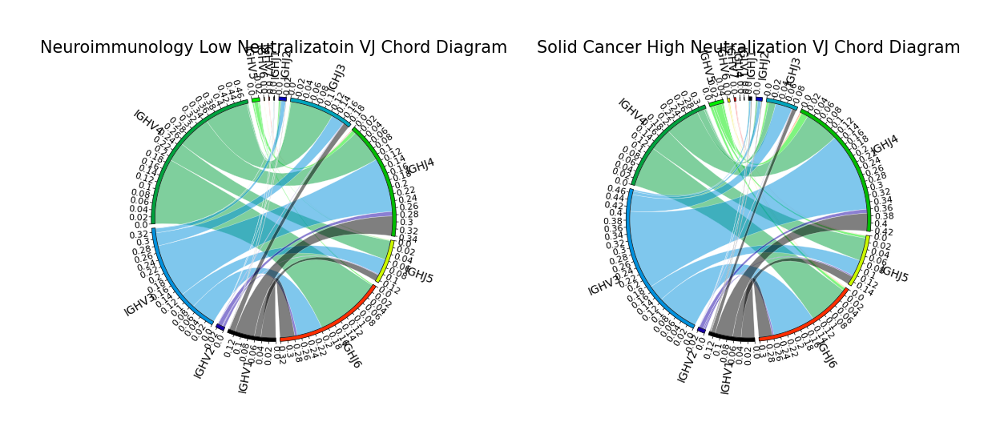

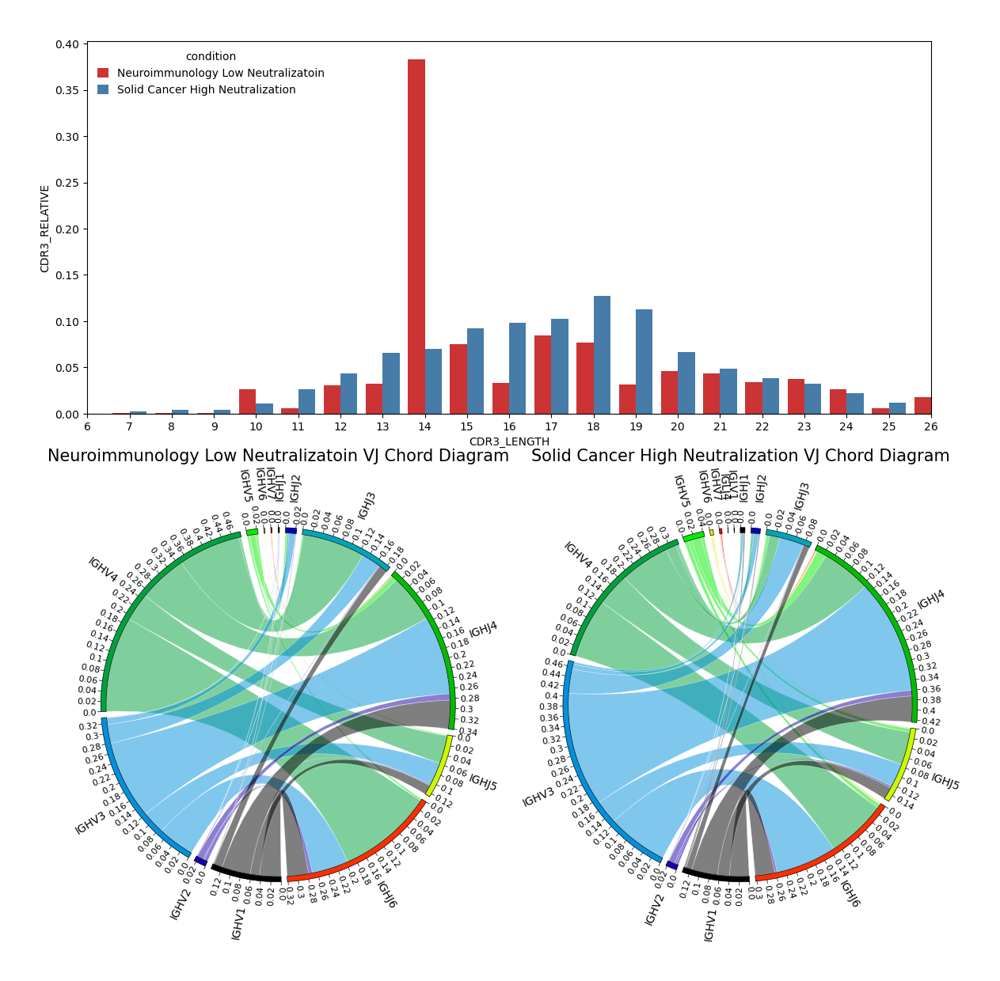

[('5bdeb2de-e95f-4fb0-94ee-6ef9c319ddb4', 'Solid Cancer High Neutralization'), ('66b5eec4-8411-456e-b02a-c0a380ba6a13', 'Solid Cancer Low Neutralization')]


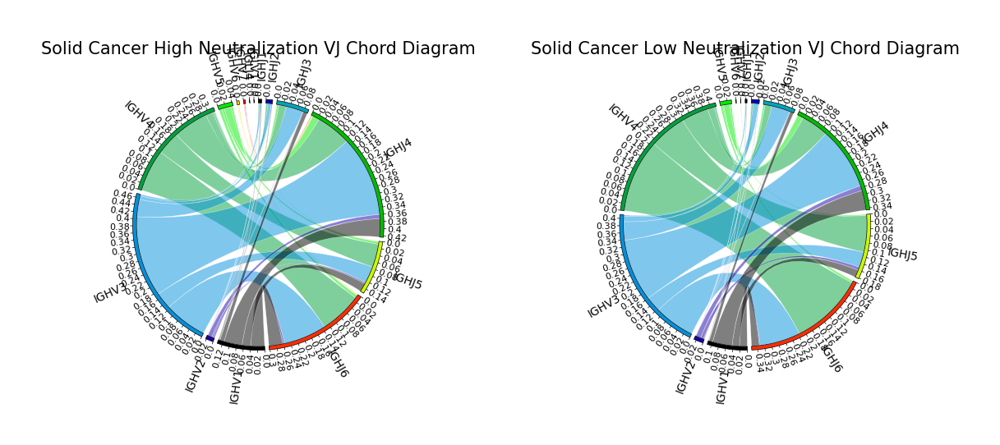

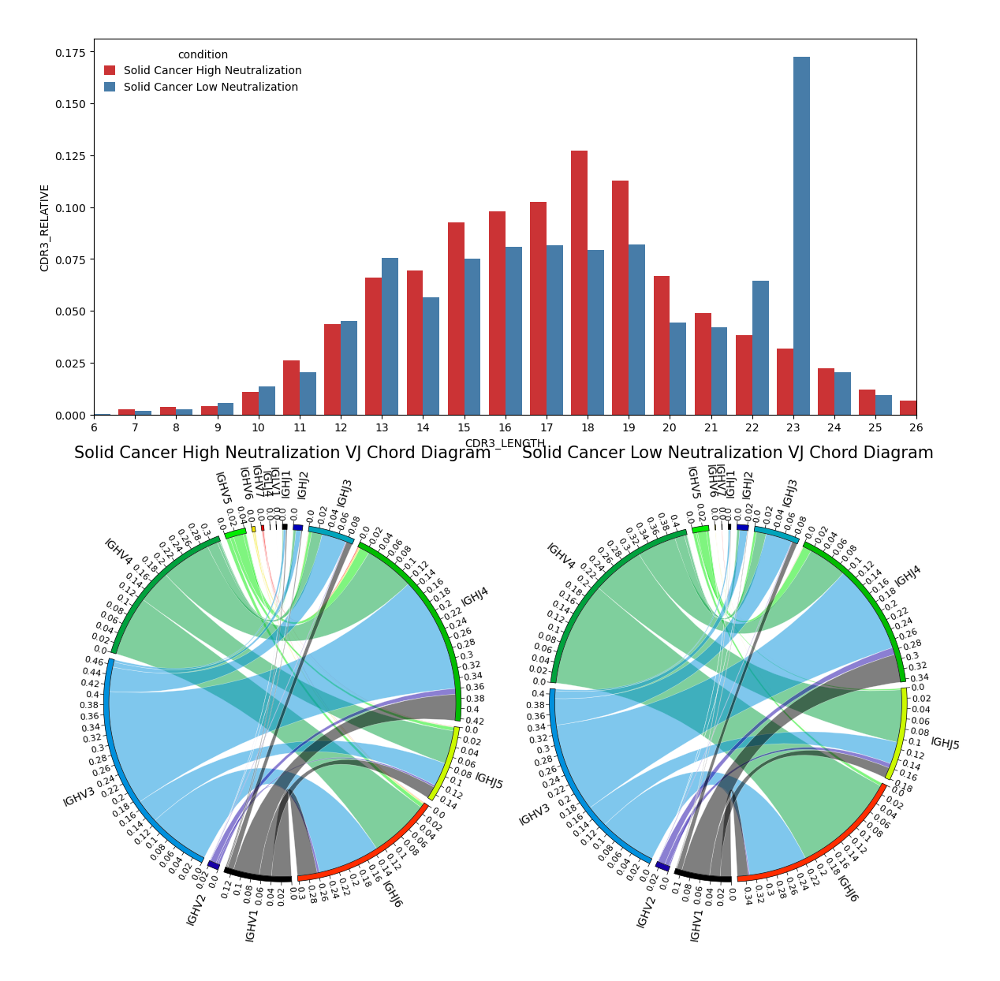

In [13]:
for i, (group_id, group_name) in enumerate(groups):

    if i!=0:
        small_group = [
            (prev_group_id, prev_group_name),
            (group_id, group_name)
        ]
        
        def plot1(ax):    
            df = br.load_and_prepare_data_junction_aa(
                repcalc_dir=repcalc_dir,
                groups=small_group,
                processing_stage='.igblast.makedb.allele.clone.group.',
                call_type='junction_aa_length'
            )

            gr.plot_junction_aa_length(
                df=df,
                x_col='CDR3_LENGTH',
                y_col='CDR3_RELATIVE',
                hue_col='condition',
                ax=ax,
                aa_range=(6,26)
            )

        def plot2(ax):
            df = br.load_and_prepare_data_vj_combo(
                repcalc_dir=repcalc_dir,
                group_id=prev_group_id,
                combo_type='vj_combo',
                processing_stage='.igblast.makedb.group.'
            )

            gr.plot_vj_chord_diagram(
                df=df,
                freq_col='duplicate_frequency_avg',
                ticks_interval=0.02,
                max_links=None,
                cmap=v_subgroup_cmap | j_subgroup_cmap,
                title=prev_group_name+' VJ Chord Diagram',
                ax=ax
            )
        
        def plot3(ax):
            df = br.load_and_prepare_data_vj_combo(
                repcalc_dir=repcalc_dir,
                group_id=group_id,
                combo_type='vj_combo',
                processing_stage='.igblast.makedb.group.'
            )

            gr.plot_vj_chord_diagram(
                df=df,
                freq_col='duplicate_frequency_avg',
                ticks_interval=0.02,
                max_links=None,
                cmap=v_subgroup_cmap | j_subgroup_cmap,
                title=group_name+' VJ Chord Diagram',
                ax=ax
            )
    
    if i!=0:
        fig, axes = plot_two_side_by_side(plot2, plot3, figsize=(12, 8), sharey=True, suptitle=None)
        fig.show()
        fig, axes = plot_three_split_layout(plot1, plot2, plot3, figsize=(12, 12), suptitle=None)
        fig.show()

    prev_group_id = group_id
    prev_group_name = group_name

## V/J Call Gene Usage & Duplicate Frequency

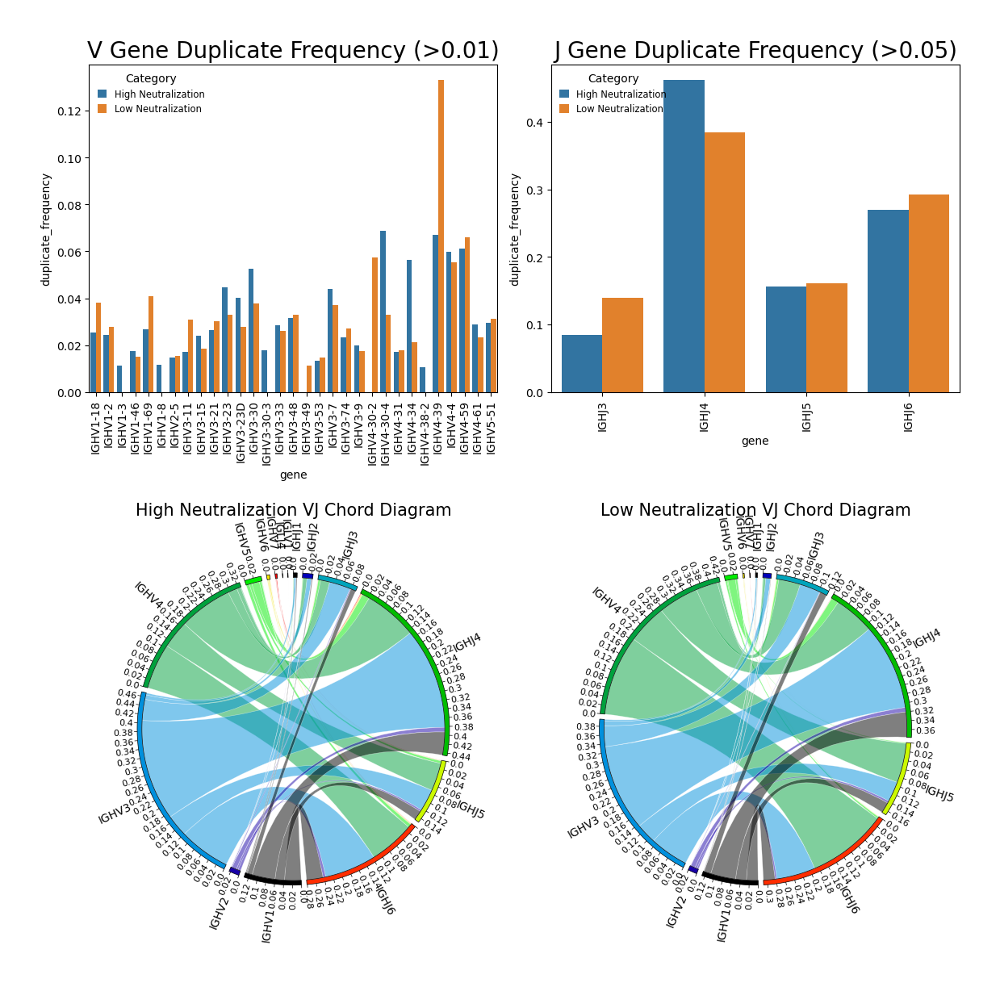

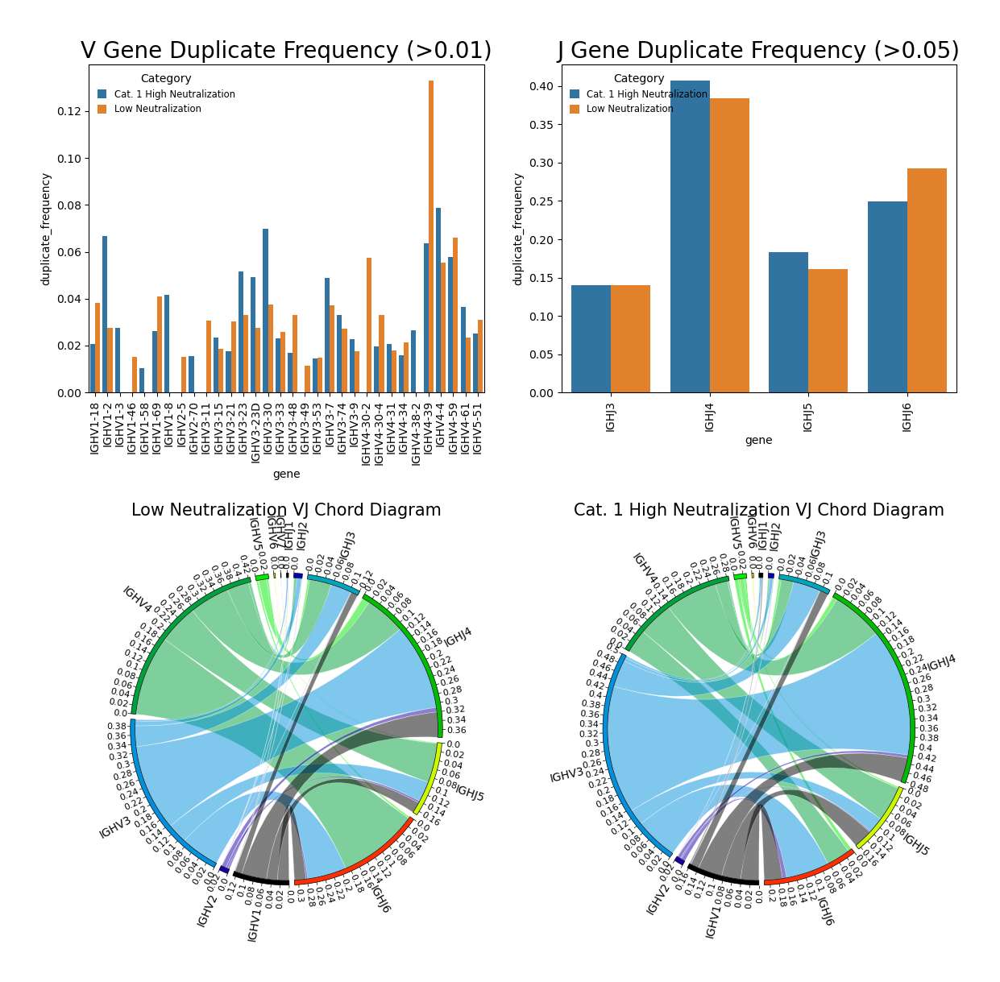

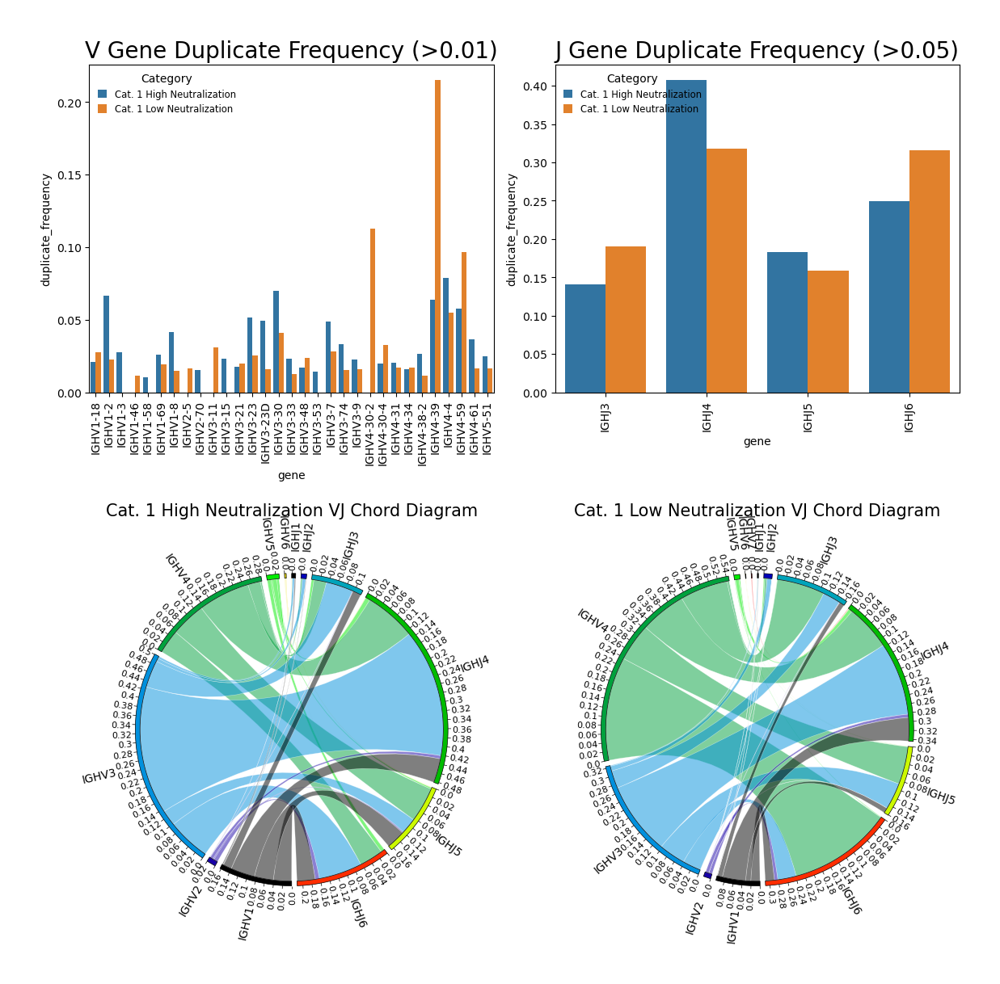

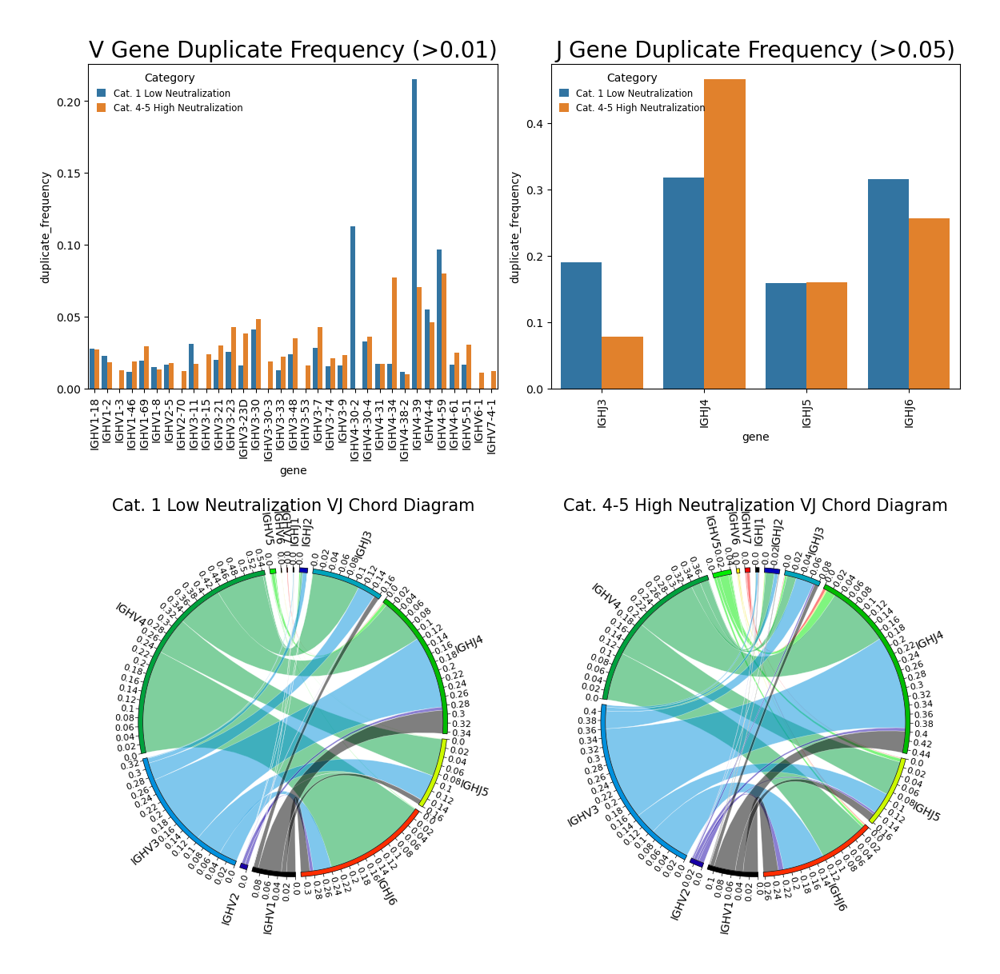

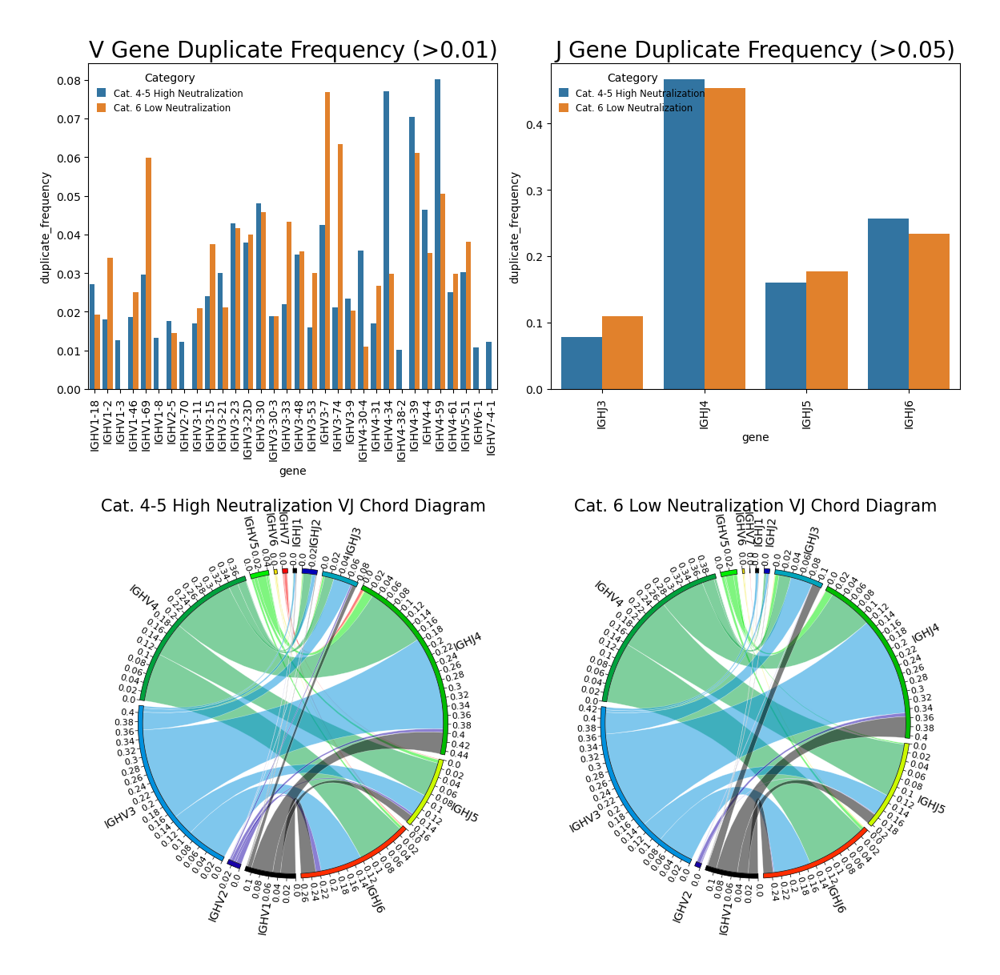

...

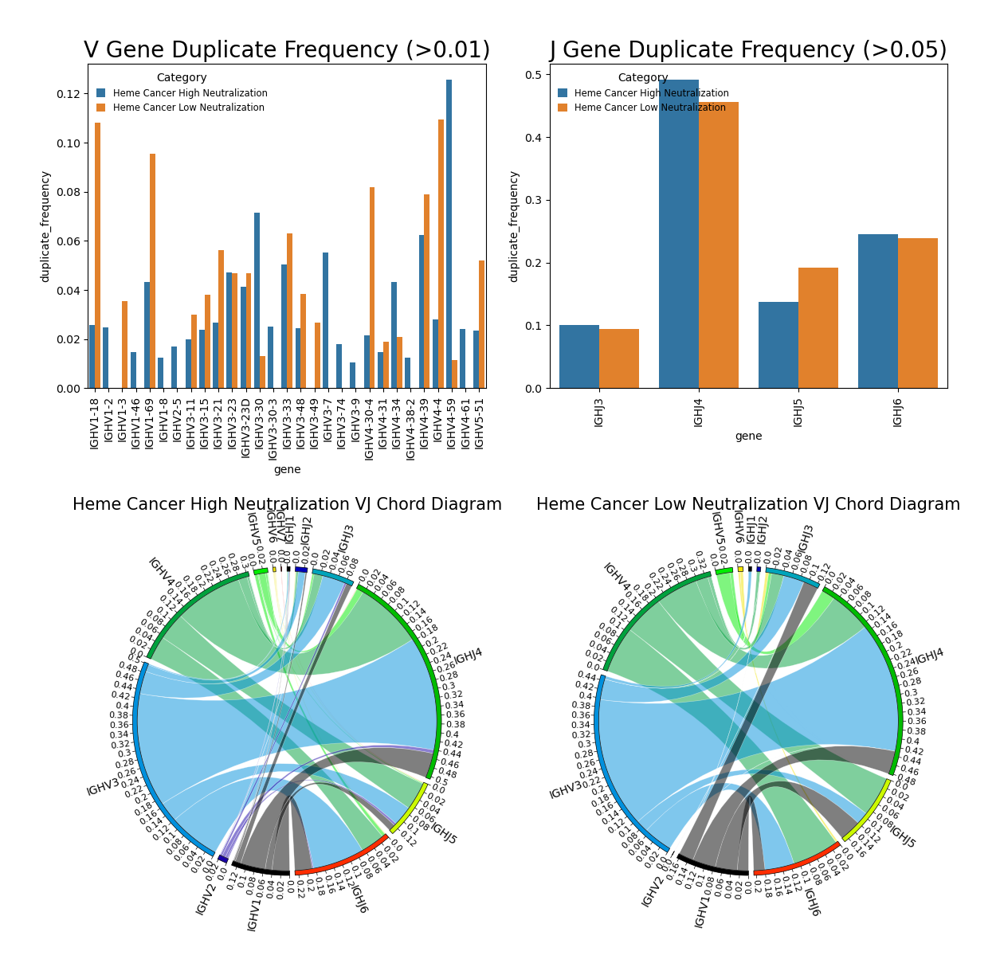

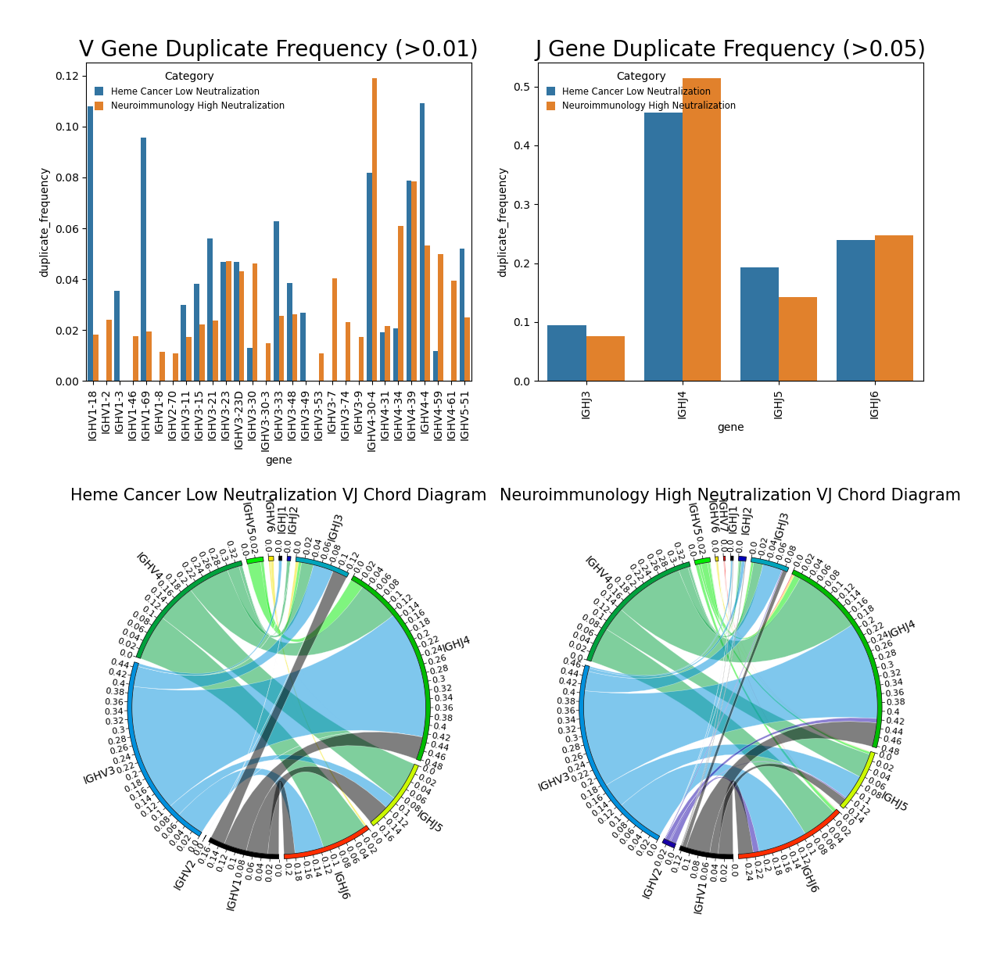

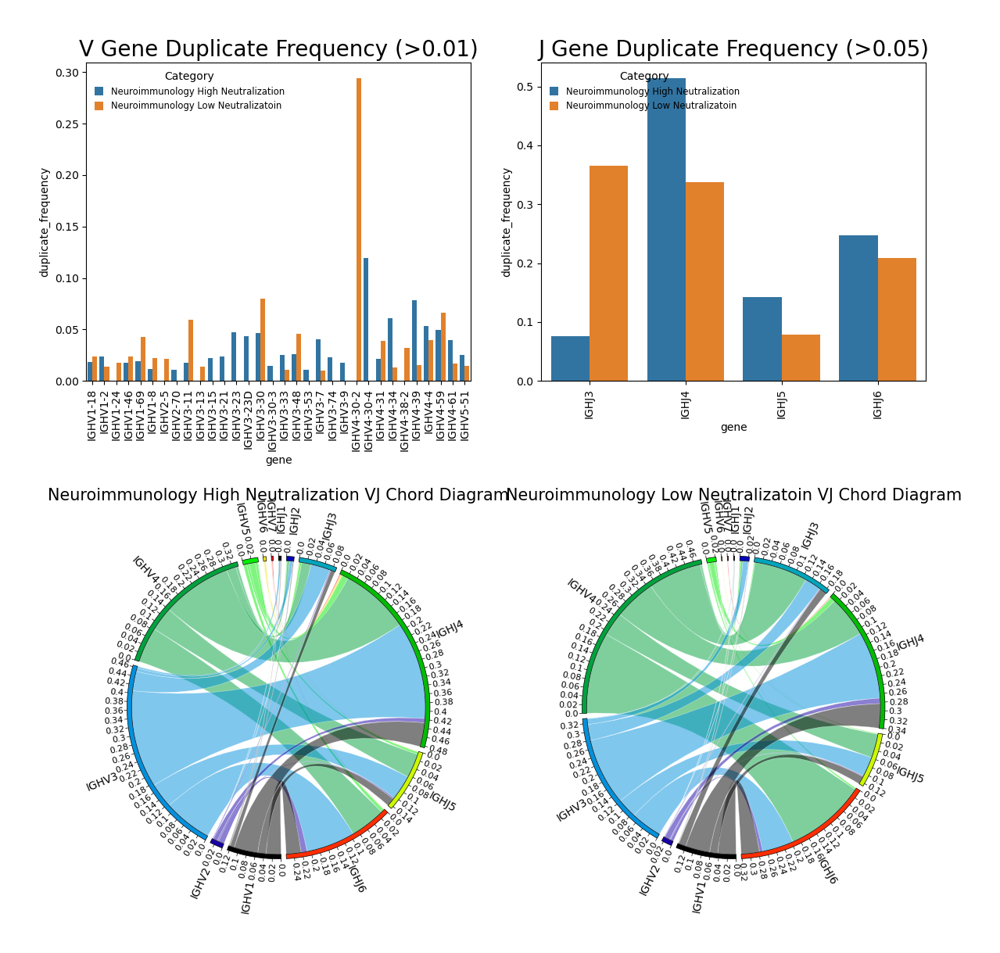

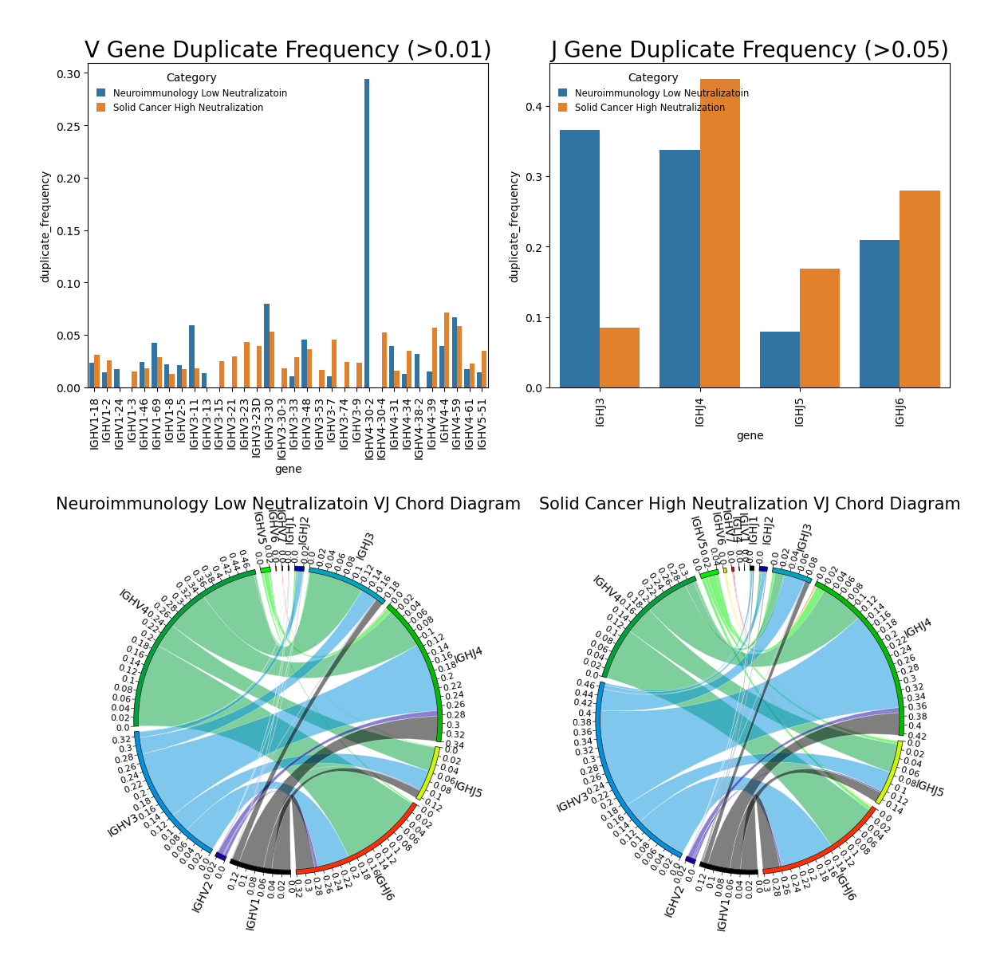

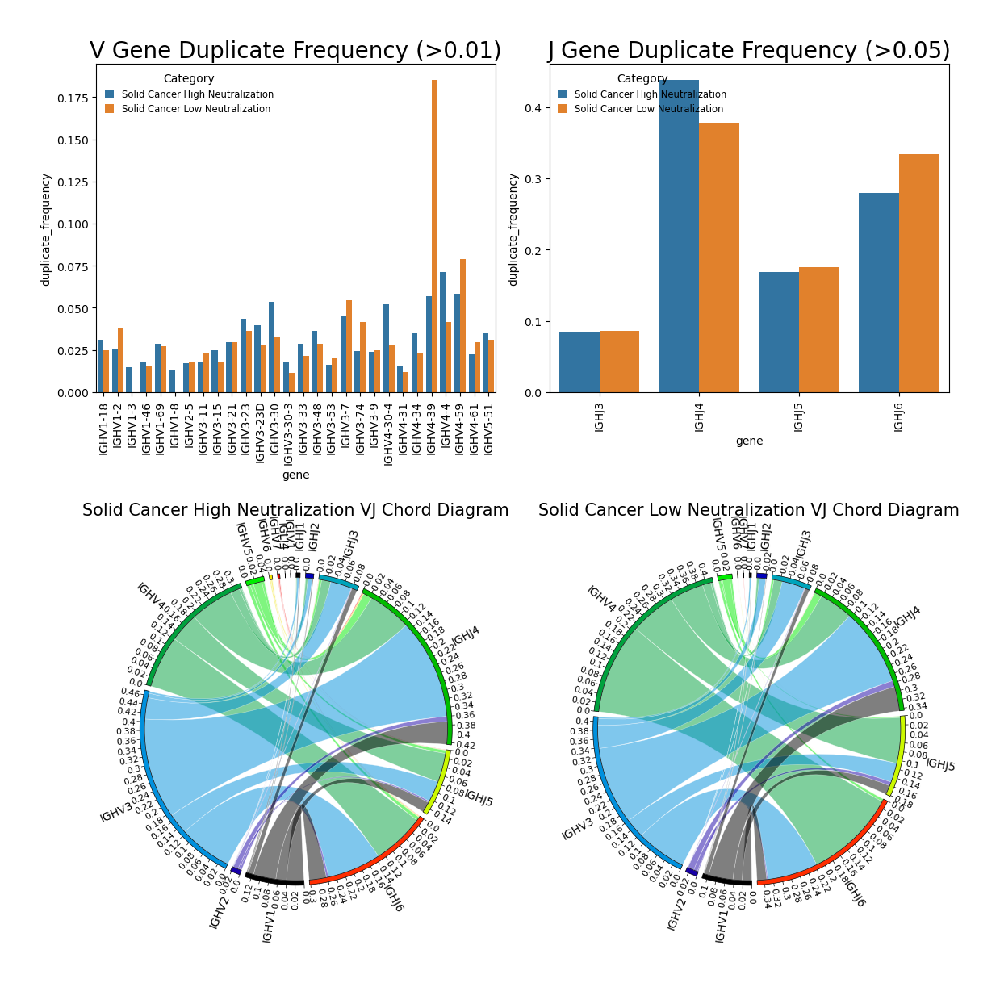

In [14]:
for i, (group_id, group_name) in enumerate(groups):

    if i!=0:
        small_group = [
            (prev_group_id, prev_group_name),
            (group_id, group_name)
        ]

        def plot_top_left(ax):
            # V dup freq
            threshold = 0.01
            ylim_mult = 0

            df = br.load_gene_usage_group_data(
                repcalc_dir=repcalc_dir,
                groups=small_group,
                processing_stage='igblast.makedb.gene.clone',
                call_type='v_call',
                level='gene'
            )

            gr.plot_duplicate_frequency(
                df=df,
                threshold=threshold,
                title=f'V Gene Duplicate Frequency (>{threshold})',
                ylim=(ylim_mult*threshold, None),
                ax=ax,
                split=True
            )

        def plot_top_right(ax):
            threshold = 0.05
            ylim_mult = 0

            df = br.load_gene_usage_group_data(
                repcalc_dir=repcalc_dir,
                groups=small_group,
                processing_stage='igblast.makedb.gene.clone',
                call_type='j_call',
                level='gene'
            )

            gr.plot_duplicate_frequency(
                df=df,
                threshold=0.05,
                title=f'J Gene Duplicate Frequency (>{threshold})',
                ylim=(threshold*ylim_mult, None),
                ax=ax,
                split=True
            )

        def plot_bottom_left(ax):
            df = br.load_and_prepare_data_vj_combo(
                repcalc_dir=repcalc_dir,
                group_id=small_group[0][0],
                combo_type='vj_combo',
                processing_stage='.igblast.makedb.group.'
            )

            gr.plot_vj_chord_diagram(
                df=df,
                freq_col='duplicate_frequency_avg',
                ticks_interval=0.02,
                max_links=None,
                cmap=v_subgroup_cmap | j_subgroup_cmap,
                title=small_group[0][1]+' VJ Chord Diagram',
                ax=ax
            )

        def plot_bottom_right(ax):
            df = br.load_and_prepare_data_vj_combo(
                repcalc_dir=repcalc_dir,
                group_id=small_group[1][0],
                combo_type='vj_combo',
                processing_stage='.igblast.makedb.group.'
            )

            gr.plot_vj_chord_diagram(
                df=df,
                freq_col='duplicate_frequency_avg',
                ticks_interval=0.02,
                max_links=None,
                cmap=v_subgroup_cmap | j_subgroup_cmap,
                title=small_group[1][1]+' VJ Chord Diagram',
                ax=ax
            )

        plot_two_by_two_layout(
            plot_top_left,
            plot_top_right,
            plot_bottom_left,
            plot_bottom_right
        )

    prev_group_id = group_id
    prev_group_name = group_name